In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from scipy import stats
%matplotlib inline

In [2]:
import warnings;
warnings.filterwarnings('ignore');

In [3]:
!pip freeze

absl-py @ file:///home/conda/feedstock_root/build_artifacts/absl-py_1633452298659/work
adjustText==0.7.3
aiohttp @ file:///C:/ci/aiohttp_1632750093640/work
alabaster @ file:///home/ktietz/src/ci/alabaster_1611921544520/work
altair @ file:///tmp/build/80754af9/altair_1599835197802/work
anaconda-client @ file:///C:/ci/anaconda-client_1624480273070/work
anaconda-navigator==2.1.0
anyio @ file:///C:/ci/anyio_1620153418380/work/dist
appdirs==1.4.4
argh==0.26.2
argon2-cffi @ file:///C:/ci/argon2-cffi_1613037959010/work
asn1crypto @ file:///tmp/build/80754af9/asn1crypto_1596577642040/work
astor==0.8.1
astroid @ file:///C:/ci/astroid_1628063293445/work
astunparse @ file:///home/conda/feedstock_root/build_artifacts/astunparse_1610696312422/work
async-generator @ file:///home/ktietz/src/ci/async_generator_1611927993394/work
async-timeout==3.0.1
atomicwrites==1.4.0
attrs @ file:///tmp/build/80754af9/attrs_1620827162558/work
autopep8 @ file:///tmp/build/80754af9/autopep8_1615918855173/work
Babel @ 

In [4]:
!pip install pandas

In [5]:
print('Pandas version:',pd.__version__)

Pandas version: 1.3.3


# Pré-analyse
## Dataset Source
Le jeu de données de la Banque Mondiale utilisé est disponible sur :
https://datacatalog.worldbank.org/dataset/education-statistics

## On commence l'analyse par le fichier **EdStatsCountry.csv**

In [6]:
country = pd.read_csv('EdStatsCountry.csv')
pd.set_option('display.max_colwidth', None) #Visualiser le maximum possible d'information
pd.set_option('display.max_rows', None) #Visualiser le maximum possible d'information
pd.set_option('display.max_columns', None) #Visualiser le maximum possible d'information
country.head(2)

,Country Code,Short Name,Table Name,Long Name,2-alpha code,Currency Unit,Special Notes,Region,Income Group,WB-2 code,National accounts base year,National accounts reference year,SNA price valuation,Lending category,Other groups,System of National Accounts,Alternative conversion factor,PPP survey year,Balance of Payments Manual in use,External debt Reporting status,System of trade,Government Accounting concept,IMF data dissemination standard,Latest population census,Latest household survey,Source of most recent Income and expenditure data,Vital registration complete,Latest agricultural census,Latest industrial data,Latest trade data,Latest water withdrawal data,Unnamed: 31
0,ABW,Aruba,Aruba,Aruba,AW,Aruban florin,SNA data for 2000-2011 are updated from official government statistics; 1994-1999 from UN databases. Base year has changed from 1995 to 2000.,Latin America & Caribbean,High income: nonOECD,AW,2000,NaN,Value added at basic prices (VAB),NaN,NaN,Country uses the 1993 System of National Accounts methodology.,NaN,NaN,"IMF Balance of Payments Manual, 6th edition.",NaN,Special trade system,NaN,NaN,2010,NaN,NaN,Yes,NaN,NaN,2012.0,NaN,NaN
1,AFG,Afghanistan,Afghanistan,Islamic State of Afghanistan,AF,Afghan afghani,Fiscal year end: March 20; reporting period for national accounts data: FY (from 2013 are CY). National accounts data are sourced from the IMF and differ from the Central Statistics Organization numbers due to exclusion of the opium economy.,South Asia,Low income,AF,2002/03,NaN,Value added at basic prices (VAB),IDA,HIPC,Country uses the 1993 System of National Accounts methodology.,NaN,NaN,NaN,Actual,General trade system,Consolidated central government,General Data Dissemination System (GDDS),1979,"Multiple Indicator Cluster Survey (MICS), 2010/11","Integrated household survey (IHS), 2008",NaN,2013/14,NaN,2012.0,2000,NaN


On voit que le fichier source **EdStatsCountry.csv** contient des informations globales sur l'économie de chaque élément dans la liste. Les listes des variables disponibles dans la source sont :

In [7]:
country.columns

Index(['Country Code', 'Short Name', 'Table Name', 'Long Name', '2-alpha code',
       'Currency Unit', 'Special Notes', 'Region', 'Income Group', 'WB-2 code',
       'National accounts base year', 'National accounts reference year',
       'SNA price valuation', 'Lending category', 'Other groups',
       'System of National Accounts', 'Alternative conversion factor',
       'PPP survey year', 'Balance of Payments Manual in use',
       'External debt Reporting status', 'System of trade',
       'Government Accounting concept', 'IMF data dissemination standard',
       'Latest population census', 'Latest household survey',
       'Source of most recent Income and expenditure data',
       'Vital registration complete', 'Latest agricultural census',
       'Latest industrial data', 'Latest trade data',
       'Latest water withdrawal data', 'Unnamed: 31'],
      dtype='object')

In [8]:
country.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 241 entries, 0 to 240
Data columns (total 32 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Country Code                                       241 non-null    object 
 1   Short Name                                         241 non-null    object 
 2   Table Name                                         241 non-null    object 
 3   Long Name                                          241 non-null    object 
 4   2-alpha code                                       238 non-null    object 
 5   Currency Unit                                      215 non-null    object 
 6   Special Notes                                      145 non-null    object 
 7   Region                                             214 non-null    object 
 8   Income Group                                       214 non-null    object 
 9   WB-2 code 

In [9]:
country.shape

(241, 32)

Le méthode ***shape*** donne comme résultat 241 dimensions mais l'ONU a 193 Etats membres, 2 Etats observateurs (le Vatican et l'Etat de Palestine) et 11 autres Etats membres des divers Agences Spécialisées. Cette liste donne le total de 206 Etats.

Donc, comment est-ce qu'on peut expliquer cette différence entre 240 éléments et 193 Etats membres ?

Source : 
       [Etats Membres de l'ONU](https://fr.wikisource.org/wiki/%C3%89tats_Membres_de_l%E2%80%99ONU), [Liste des pays du monde](https://en.wikipedia.org/wiki/List_of_sovereign_states#Artsakh)

In [10]:
print(country['Short Name']) #Liste des éléments dans la colonne 'Short Name'

0                                               Aruba
1                                         Afghanistan
2                                              Angola
3                                             Albania
4                                             Andorra
5                                          Arab World
6                                United Arab Emirates
7                                           Argentina
8                                             Armenia
9                                      American Samoa
10                                Antigua and Barbuda
11                                          Australia
12                                            Austria
13                                         Azerbaijan
14                                            Burundi
15                                            Belgium
16                                              Benin
17                                       Burkina Faso
18                          

Rapidement on voit que la liste contient des noms qui correspondent aux zones. Comme par exemple : *Latin America & Caribbean (developing only)*

La Banque Mondiale fournit comme détail la liste de couverture suivante :

> World East Asia & Pacific American Samoa Australia Brunei Darussalam Cambodia China Fiji French Polynesia Guam Hong Kong SAR, China Indonesia Japan Kiribati Korea, Dem. People's Rep. Korea, Rep. Lao PDR Macao SAR, China Malaysia Marshall Islands Mongolia Myanmar Nauru New Caledonia New Zealand Northern Mariana Islands Palau Papua New Guinea Philippines Samoa Singapore Solomon Islands Thailand Timor-Leste Tonga Tuvalu Vanuatu Vietnam Europe & Central Asia Albania Andorra Armenia Austria Azerbaijan Belarus Belgium Bosnia and Herzegovina Bulgaria Croatia Cyprus Czech Republic Denmark Estonia Faroe Islands Finland France Georgia Germany Gibraltar Greece Greenland Hungary Iceland Ireland Isle of Man Italy Kazakhstan Kyrgyz Republic Latvia Liechtenstein Lithuania Luxembourg Moldova Monaco Montenegro Netherlands North Macedonia Norway Poland Portugal Romania Russian Federation San Marino Serbia Slovak Republic Slovenia Spain Sweden Switzerland Tajikistan Turkey Turkmenistan Ukraine United Kingdom Uzbekistan Latin America & Caribbean Antigua and Barbuda Aruba Argentina Bahamas, The Barbados Belize Bolivia Brazil Cayman Islands Chile Costa Rica Colombia Cuba Curaçao Dominica Dominican Republic Ecuador El Salvador Grenada Guatemala Guyana Haiti Honduras Jamaica Mexico Nicaragua Panama Paraguay Peru Puerto Rico Sint Maarten (Dutch part) St. Kitts and Nevis St. Martin (French part) St. Lucia St. Vincent and the Grenadines Suriname Trinidad and Tobago Turks and Caicos Islands Uruguay Venezuela, RB Virgin Islands (U.S.) Middle East & North Africa Algeria Bahrain Egypt, Arab Rep. Djibouti Iraq Iran, Islamic Rep. Israel Jordan Kuwait Lebanon Libya Malta Morocco Oman Qatar Saudi Arabia Syrian Arab Republic United Arab Emirates Tunisia Yemen, Rep. Bermuda Canada United States South Asia Afghanistan Bangladesh Bhutan India Pakistan Nepal Maldives Sri Lanka Angola Benin Botswana Burkina Faso Burundi Cabo Verde Cameroon Central African Republic Chad Comoros Congo, Dem. Rep. Congo, Rep. Côte d'Ivoire Ethiopia Eritrea Equatorial Guinea Gabon Gambia, The Ghana Guinea Guinea-Bissau Kenya Lesotho Liberia Madagascar Malawi Mali Mauritania Mauritius Mozambique Namibia Niger Nigeria Rwanda São Tomé and Principe Seychelles Senegal Sierra Leone Somalia South Africa South Sudan Sudan Eswatini Tanzania Togo Uganda Zambia Zimbabwe

In [11]:
#Liste des zones dans tous les csv sources
zones = ['Arab World',
         'East Asia & Pacific',
         'East Asia & Pacific (developing only)',
         'East Asia & Pacific (all income levels)',
         'East Asia & Pacific (excluding high income)',
         'Europe & Central Asia',
         'Europe & Central Asia (developing only)',
         'Europe & Central Asia (all income levels)',
         'Europe & Central Asia (excluding high income)',
         'Euro area',
         'European Union',
         'High income',
         'Heavily indebted poor countries (HIPC)',
         'Latin America & Caribbean',
         'Latin America & Caribbean (developing only)',
         'Latin America & Caribbean (all income levels)',
         'Latin America & Caribbean (excluding high income)',
         'Least developed countries: UN classification',
         'Low income',
         'Lower middle income',
         'Low & middle income',
         'Middle income',
         'Middle East & North Africa',
         'Middle East & North Africa (all income levels)',
         'Middle East & North Africa (developing only)',
         'Middle East & North Africa (excluding high income)',
         'North America',
         'OECD members',
         'South Asia',
         'Sub-Saharan Africa',
         'Sub-Saharan Africa (developing only)',
         'Sub-Saharan Africa (all income levels)',
         'Sub-Saharan Africa (excluding high income)',
         'Upper middle income',
         'World',]

In [12]:
country[~country['Short Name'].isin(zones)]['Short Name'].unique().shape

(216,)

In [13]:
countriesList = country[~country['Short Name'].isin(zones)]['Short Name'].unique().tolist()
print(countriesList)

['Aruba', 'Afghanistan', 'Angola', 'Albania', 'Andorra', 'United Arab Emirates', 'Argentina', 'Armenia', 'American Samoa', 'Antigua and Barbuda', 'Australia', 'Austria', 'Azerbaijan', 'Burundi', 'Belgium', 'Benin', 'Burkina Faso', 'Bangladesh', 'Bulgaria', 'Bahrain', 'The Bahamas', 'Bosnia and Herzegovina', 'Belarus', 'Belize', 'Bermuda', 'Bolivia', 'Brazil', 'Barbados', 'Brunei', 'Bhutan', 'Botswana', 'Central African Republic', 'Canada', 'Switzerland', 'Channel Islands', 'Chile', 'China', "Côte d'Ivoire", 'Cameroon', 'Dem. Rep. Congo', 'Congo', 'Colombia', 'Comoros', 'Cabo Verde', 'Costa Rica', 'Cuba', 'Curaçao', 'Cayman Islands', 'Cyprus', 'Czech Republic', 'Germany', 'Djibouti', 'Dominica', 'Denmark', 'Dominican Republic', 'Algeria', 'Ecuador', 'Egypt', 'Eritrea', 'Spain', 'Estonia', 'Ethiopia', 'Finland', 'Fiji', 'France', 'Faeroe Islands', 'Micronesia', 'Gabon', 'United Kingdom', 'Georgia', 'Ghana', 'Gibraltar', 'Guinea', 'The Gambia', 'Guinea-Bissau', 'Equatorial Guinea', 'Greec

On voit que la nouvelle liste de pays (216 éléments) n'est pas seulement composée par des pays (193 selon l'ONU) sinon aussi par des régions comme par exemple :
- *Greenland* et *Faroe Islands*, territoires indépendants composants du Royaume de Danemark
- *St. Martin (French part)*, *Sint Maarten (Dutch part)*; le premier est une collectivité d'outre-mer française et le deuxième est un pays constitutif du Royaume des Pays-Bas
- *Hong Kong SAR, China* et *Macao SAR, China*, deux régions administratives spéciales de la République Populaire de Chine

Comme chaque pays et région a ses propres indicateurs et pour éviter de donner une teinte politique à l'analyse, nous travaillerons en considérant chaque élément de la liste comme un pays différent.

Dans le cas de la République de Chine (Taiwan), elle sera ignorée car elle est considerée par la Banque Mondiale et l'ONU comme une province de la République Populaire de Chine. Les mêmes critères seront appliqués à : *Abkhazia, Artsakh, Cook Islands, Niue, Northern Cyprus, Sahrawi Arab Democratic Republic, Somaliland, South Ossetia* et *Transnistria*. Dans le cas particulier du Kosovo, elle est incluse dans l'analyse parce que ses indicateurs font partie de la source des données et pas pour une question politique.

In [14]:
#Contenu de la colonne 'Region'
regionsList = country['Region'].unique().tolist()
print(regionsList)

['Latin America & Caribbean', 'South Asia', 'Sub-Saharan Africa', 'Europe & Central Asia', nan, 'Middle East & North Africa', 'East Asia & Pacific', 'North America']


In [15]:
#Liste de 'Region' sans l'élément 'nan'
regions = ['Latin America & Caribbean',
           'South Asia',
           'Sub-Saharan Africa',
           'Europe & Central Asia',
           'Middle East & North Africa',
           'East Asia & Pacific',
           'North America']

In [16]:
regionsList = country[country['Region'].isin(regions)]['Region'].unique().tolist()
print(regionsList)

['Latin America & Caribbean', 'South Asia', 'Sub-Saharan Africa', 'Europe & Central Asia', 'Middle East & North Africa', 'East Asia & Pacific', 'North America']


In [17]:
country[country['Region'].isin(regions)]['Region'].unique().shape #Nombre des régions dans la source

(7,)

## **EdStatsData.csv**

In [18]:
data = pd.read_csv('EdStatsData.csv')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 886930 entries, 0 to 886929
Data columns (total 70 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country Name    886930 non-null  object 
 1   Country Code    886930 non-null  object 
 2   Indicator Name  886930 non-null  object 
 3   Indicator Code  886930 non-null  object 
 4   1970            72288 non-null   float64
 5   1971            35537 non-null   float64
 6   1972            35619 non-null   float64
 7   1973            35545 non-null   float64
 8   1974            35730 non-null   float64
 9   1975            87306 non-null   float64
 10  1976            37483 non-null   float64
 11  1977            37574 non-null   float64
 12  1978            37576 non-null   float64
 13  1979            36809 non-null   float64
 14  1980            89122 non-null   float64
 15  1981            38777 non-null   float64
 16  1982            37511 non-null   float64
 17  1983      

In [19]:
data.shape

(886930, 70)

In [20]:
print(data['Country Name'].unique())

['Arab World' 'East Asia & Pacific'
 'East Asia & Pacific (excluding high income)' 'Euro area'
 'Europe & Central Asia' 'Europe & Central Asia (excluding high income)'
 'European Union' 'Heavily indebted poor countries (HIPC)' 'High income'
 'Latin America & Caribbean'
 'Latin America & Caribbean (excluding high income)'
 'Least developed countries: UN classification' 'Low & middle income'
 'Low income' 'Lower middle income' 'Middle East & North Africa'
 'Middle East & North Africa (excluding high income)' 'Middle income'
 'North America' 'OECD members' 'South Asia' 'Sub-Saharan Africa'
 'Sub-Saharan Africa (excluding high income)' 'Upper middle income'
 'World' 'Afghanistan' 'Albania' 'Algeria' 'American Samoa' 'Andorra'
 'Angola' 'Antigua and Barbuda' 'Argentina' 'Armenia' 'Aruba' 'Australia'
 'Austria' 'Azerbaijan' 'Bahamas, The' 'Bahrain' 'Bangladesh' 'Barbados'
 'Belarus' 'Belgium' 'Belize' 'Benin' 'Bermuda' 'Bhutan' 'Bolivia'
 'Bosnia and Herzegovina' 'Botswana' 'Brazil' 'British

In [21]:
print(data['Indicator Name'].unique())
print('')
print('Observations uniques Indicator Name : ',data['Indicator Name'].nunique())
print('Observations uniques Indicator Code : ',data['Indicator Code'].nunique())
print('Observations uniques Country Name : ',data['Country Name'].nunique())
print('Observations uniques Country Code : ',data['Country Code'].nunique())
print('')
print("Y a-t-il une liste pour chaque pays pour chacun des 3665 indicateurs ?",data['Indicator Name'].nunique()*data['Country Code'].nunique() == data.shape[0])

['Adjusted net enrolment rate, lower secondary, both sexes (%)'
 'Adjusted net enrolment rate, lower secondary, female (%)'
 'Adjusted net enrolment rate, lower secondary, gender parity index (GPI)'
 ... 'Youth literacy rate, population 15-24 years, female (%)'
 'Youth literacy rate, population 15-24 years, gender parity index (GPI)'
 'Youth literacy rate, population 15-24 years, male (%)']

Observations uniques Indicator Name :  3665
Observations uniques Indicator Code :  3665
Observations uniques Country Name :  242
Observations uniques Country Code :  242

Y a-t-il une liste pour chaque pays pour chacun des 3665 indicateurs ? True


242 face à 216 dans le fichier **EdStatsCountry.csv**. Où se trouve la diffèrence ?

In [22]:
data[~data['Country Name'].isin(zones)]['Country Name'].unique().shape #On enlève les zones de la liste

(217,)

Quel est le pays différent ? 217 face à 216.

In [23]:
countriesListData = data[~data['Country Name'].isin(zones)]['Country Name'].unique().tolist()

In [24]:
diff_CountryVsData = list(set(countriesListData) - set(countriesList))
print(diff_CountryVsData)
print('Différences de nom du pays :',len(diff_CountryVsData))

['Venezuela, RB', 'Yemen, Rep.', 'Brunei Darussalam', 'Iran, Islamic Rep.', 'Congo, Dem. Rep.', 'Gambia, The', 'Bahamas, The', 'Sao Tome and Principe', 'Korea, Dem. People’s Rep.', 'Micronesia, Fed. Sts.', 'Curacao', 'Egypt, Arab Rep.', 'Macedonia, FYR', 'Russian Federation', 'Congo, Rep.', 'British Virgin Islands', 'Faroe Islands', "Cote d'Ivoire", 'Virgin Islands (U.S.)', 'Korea, Rep.']
Différences de nom du pays : 20


Cette différence est-elle reproduite dans les *Country Code* ?

In [25]:
codesList = country[~country['Short Name'].isin(zones)]['Country Code'].unique().tolist()
#print(codesList)
codesListData = data[~data['Country Name'].isin(zones)]['Country Code'].unique().tolist()
#print(codesListData)

In [26]:
diff_CountryVsData_codes = list(set(codesListData) - set(codesList))
print(diff_CountryVsData_codes)
print('Différences de code :',len(diff_CountryVsData_codes))

['VGB']
Différences de code : 1


In [27]:
print(data[data['Country Code']=='VGB'].index.values)

[190580 190581 190582 ... 194242 194243 194244]


In [28]:
print(data[['Country Name']].iloc[190580])

Country Name    British Virgin Islands
Name: 190580, dtype: object


La source **EdStatsData.csv** ajoute les *British Virgin Islands* ISO code VGB.
Par soucis de cohérence avec la source **EdStatsCountry.csv**, *British Virgin Islands* sera ignoré.

## **EdStatsCountry-Series.csv**

In [29]:
countrySeries = pd.read_csv('EdStatsCountry-Series.csv')
countrySeries.info()
countrySeries.head(2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 613 entries, 0 to 612
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   CountryCode  613 non-null    object 
 1   SeriesCode   613 non-null    object 
 2   DESCRIPTION  613 non-null    object 
 3   Unnamed: 3   0 non-null      float64
dtypes: float64(1), object(3)
memory usage: 19.3+ KB


,CountryCode,SeriesCode,DESCRIPTION,Unnamed: 3
0,ABW,SP.POP.TOTL,Data sources : United Nations World Population Prospects,NaN
1,ABW,SP.POP.GROW,Data sources: United Nations World Population Prospects,NaN


In [30]:
print(countrySeries['CountryCode'].unique())

['ABW' 'AFG' 'AGO' 'ALB' 'AND' 'ARE' 'ARG' 'ARM' 'ASM' 'ATG' 'AUS' 'AUT'
 'AZE' 'BDI' 'BEL' 'BEN' 'BFA' 'BGD' 'BGR' 'BHR' 'BHS' 'BIH' 'BLR' 'BLZ'
 'BMU' 'BOL' 'BRA' 'BRB' 'BRN' 'BTN' 'BWA' 'CAF' 'CAN' 'CHE' 'CHI' 'CHL'
 'CHN' 'CIV' 'CMR' 'COD' 'COG' 'COL' 'COM' 'CPV' 'CRI' 'CUB' 'CYM' 'CYP'
 'CZE' 'DEU' 'DJI' 'DMA' 'DNK' 'DOM' 'DZA' 'ECU' 'EGY' 'ERI' 'ESP' 'EST'
 'ETH' 'FIN' 'FJI' 'FRA' 'FRO' 'FSM' 'GAB' 'GBR' 'GEO' 'GHA' 'GIB' 'GIN'
 'GMB' 'GNB' 'GNQ' 'GRC' 'GRD' 'GRL' 'GTM' 'GUM' 'GUY' 'HKG' 'HND' 'HRV'
 'HTI' 'HUN' 'IDN' 'IMN' 'IND' 'IRL' 'IRN' 'IRQ' 'ISL' 'ISR' 'ITA' 'JAM'
 'JOR' 'JPN' 'KAZ' 'KEN' 'KGZ' 'KHM' 'KIR' 'KNA' 'KOR' 'KWT' 'LAO' 'LBN'
 'LBR' 'LBY' 'LCA' 'LIE' 'LKA' 'LSO' 'LTU' 'LUX' 'LVA' 'MAC' 'MAR' 'MCO'
 'MDA' 'MDG' 'MDV' 'MEX' 'MHL' 'MKD' 'MLI' 'MLT' 'MMR' 'MNE' 'MNG' 'MNP'
 'MOZ' 'MRT' 'MUS' 'MWI' 'MYS' 'NAM' 'NCL' 'NER' 'NGA' 'NIC' 'NLD' 'NOR'
 'NPL' 'NZL' 'OMN' 'PAK' 'PAN' 'PER' 'PHL' 'PLW' 'PNG' 'POL' 'PRI' 'PRK'
 'PRT' 'PRY' 'PSE' 'PYF' 'QAT' 'ROU' 'RUS' 'RWA' 'S

Le fichier **EdStatsCountry-Series.csv** contient la source des informations contenues dans **EdStatsCountry.csv**

Combien de pays contient le fichier ?

In [31]:
countrySeries['CountryCode'].nunique()

211

211 face à 216 dans le fichier **EdStatsCountry.csv**. Où se trouve la différence ?

In [32]:
diffCountry = country[~country['Country Code'].isin(countrySeries['CountryCode'].unique())][['Short Name']]
diffCountry = diffCountry[~country['Short Name'].isin(zones)]['Short Name'].unique().tolist()
print(diffCountry)

['Curaçao', 'St. Martin (French part)', 'Nauru', 'South Sudan', 'Sint Maarten (Dutch part)']


Il faut travailler avec les *Country Code* car la source **EdStatsCountry-Series.csv** ne contient pas la dimension *Country Name* ou *Short Name*

In [33]:
codesList = country[country['Short Name'].isin(zones)]['Country Code'].unique().tolist()
codesListData = data[data['Country Name'].isin(zones)]['Country Code'].unique().tolist()
print(sorted(codesList))
print(sorted(codesListData))
difC = list(set(codesListData) - set(codesList))
print(difC)

['ARB', 'EAP', 'EAS', 'ECA', 'ECS', 'EMU', 'EUU', 'HIC', 'HPC', 'LAC', 'LCN', 'LDC', 'LIC', 'LMC', 'LMY', 'MEA', 'MIC', 'MNA', 'NAC', 'OED', 'SAS', 'SSA', 'SSF', 'UMC', 'WLD']
['ARB', 'EAP', 'EAS', 'ECA', 'ECS', 'EMU', 'EUU', 'HIC', 'HPC', 'LAC', 'LCN', 'LDC', 'LIC', 'LMC', 'LMY', 'MEA', 'MIC', 'MNA', 'NAC', 'OED', 'SAS', 'SSA', 'SSF', 'UMC', 'WLD']
[]


In [34]:
p = data[data['Country Code']=='UMC'].index.values
print(p)
print(data[['Country Name']].iloc[p[0]])

[84295 84296 84297 ... 87957 87958 87959]
Country Name    Upper middle income
Name: 84295, dtype: object


In [35]:
def getNamesFromCodes_data(dfObj,codes):
    pList = []
    for x in range(len(codes)):
        p = dfObj[dfObj['Country Code']==codes[x]].index.values
        v = dfObj[['Country Name']].iloc[p[0]]
        c = codes[x]
        h = 'Country :' + v + ' Code :' + c
        pList.append(h)
    return pList

In [36]:
pList = getNamesFromCodes_data(data,codesListData)
print(pList)

[Country Name    Country :Arab World Code :ARB
Name: 0, dtype: object, Country Name    Country :East Asia & Pacific Code :EAS
Name: 3665, dtype: object, Country Name    Country :East Asia & Pacific (excluding high income) Code :EAP
Name: 7330, dtype: object, Country Name    Country :Euro area Code :EMU
Name: 10995, dtype: object, Country Name    Country :Europe & Central Asia Code :ECS
Name: 14660, dtype: object, Country Name    Country :Europe & Central Asia (excluding high income) Code :ECA
Name: 18325, dtype: object, Country Name    Country :European Union Code :EUU
Name: 21990, dtype: object, Country Name    Country :Heavily indebted poor countries (HIPC) Code :HPC
Name: 25655, dtype: object, Country Name    Country :High income Code :HIC
Name: 29320, dtype: object, Country Name    Country :Latin America & Caribbean Code :LCN
Name: 32985, dtype: object, Country Name    Country :Latin America & Caribbean (excluding high income) Code :LAC
Name: 36650, dtype: object, Country Name    C

In [37]:
#Liste des codes des zones dans tous les csv sources
""""
zones = ['Arab ', #ARB
         'East Asia & Pacific', #EAS
         'East Asia & Pacific (developing only)', #EAP
         'East Asia & Pacific (all income levels)', #EAS
         'East Asia & Pacific (excluding high income)', #EAP
         'Europe & Central Asia', #ECS
         'Europe & Central Asia (developing only)', #ECA
         'Europe & Central Asia (all income levels)', #ECS
         'Europe & Central Asia (excluding high income)', #ECA
         'Euro area', #EMU
         'European Union', #EUU
         'High income', #HIC
         'Heavily indebted poor countries (HIPC)', #HPC
         'Latin America & Caribbean', #LCN
         'Latin America & Caribbean (developing only)', #LAC
         'Latin America & Caribbean (all income levels)', #LCN
         'Latin America & Caribbean (excluding high income)', #LAC
         'Least developed countries: UN classification', #LDC
         'Low income', #LIC
         'Lower middle income', #LMC
         'Low & middle income', #LMY
         'Middle income', #MIC
         'Middle East & North Africa', #MEA
         'Middle East & North Africa (all income levels)', #MEA
         'Middle East & North Africa (developing only)', #MNA
         'Middle East & North Africa (excluding high income)', #MNA
         'North America', #NAC
         'OECD members', #OED
         'South Asia', #SAS
         'Sub-Saharan Africa', #SSF
         'Sub-Saharan Africa (developing only)', #SSA
         'Sub-Saharan Africa (all income levels)', #SSF
         'Sub-Saharan Africa (excluding high income)', #SSA
         'Upper middle income', #UMC
         'World', #WLD
         ]
"""
zonesCodes = ['ARB','EAS','EAP','EAS','EAP','ECS','ECA','ECS','ECA','EMU','EUU','HIC',
              'HPC','LCN','LAC','LCN','LAC','LDC','LIC','LMC','LMY','MIC','MEA','MEA',
              'MNA','MNA','NAC','OED','SAS','SSF','SSA','SSF','SSA','UMC','WLD',]

In [38]:
diffCountry = country[~country['Country Code'].isin(countrySeries['CountryCode'].unique())][['Short Name']]
diffCountry = diffCountry[~country['Country Code'].isin(zonesCodes)]['Short Name'].unique().tolist()
print(diffCountry)

['Curaçao', 'St. Martin (French part)', 'Nauru', 'South Sudan', 'Sint Maarten (Dutch part)']


Nous vérifions si la différence se répète en utilisant uniquement les codes de pays

In [39]:
codesList = country[~country['Short Name'].isin(zones)]['Country Code'].unique().tolist()
#print(codesList)
codesListSeries = countrySeries[~countrySeries['CountryCode'].isin(zonesCodes)]['CountryCode'].unique().tolist()
#print(codesListSeries)

diff_CountryVsSeries_codes = list(set(codesList) - set(codesListSeries))
print(diff_CountryVsSeries_codes)
print('Différences de code :',len(diff_CountryVsSeries_codes))

['CUW', 'SSD', 'NRU', 'SXM', 'MAF']
Différences de code : 5


In [40]:
def getNamesFromCodes_country(dfObj,codes):
    pList = []
    for x in range(len(codes)):
        p = dfObj[dfObj['Country Code']==codes[x]].index.values
        v = dfObj[['Short Name']].iloc[p[0]]
        c = codes[x]
        h = 'Country :' + v + ' Code :' + c
        pList.append(h)
    return pList

In [41]:
cList = getNamesFromCodes_country(country,diff_CountryVsSeries_codes)
print(cList)

[Short Name    Country :Curaçao Code :CUW
Name: 47, dtype: object, Short Name    Country :South Sudan Code :SSD
Name: 199, dtype: object, Short Name    Country :Nauru Code :NRU
Name: 166, dtype: object, Short Name    Country :Sint Maarten (Dutch part) Code :SXM
Name: 207, dtype: object, Short Name    Country :St. Martin (French part) Code :MAF
Name: 134, dtype: object]


En effet, la différence se répète.

Les codes suivants seront ignorés :

| Country | CODE |
| --- | --- | 
| British Virgin Islands | VGB |
| Curaçao | CUW |
| Nauru | NRU |
| South Sudan | SSD |
| St. Martin (French part) | MAF |
| Sint Maarten (Dutch part) | SXM |



In [42]:
country_dropped = pd.read_csv('EdStatsCountry.csv')
data_dropped = pd.read_csv('EdStatsData.csv')

## Index des pays à dropper

### **EdStatsCountry.csv** et **EdStatsData.csv**

In [43]:
sixDropped = ['VGB','CUW','NRU','SSD','MAF','SXM']
index_names_country = country[country['Country Code'].isin(sixDropped)].index
index_names_data = data[data['Country Code'].isin(sixDropped)].index

In [44]:
country_dropped.drop(index_names_country, inplace = True)
data_dropped.drop(index_names_data, inplace = True)

In [45]:
print('Taille originale du fichier EdStatsCountry.csv :',country.shape)
print('Taille originale fichier EdStatsCountry.csv sans les 6 codes à dropper:',country_dropped.shape)
print('Taille originale du fichier EdStatsData.csv :',data.shape)
print('Taille originale fichier EdStatsData.csv sans les 6 codes à dropper:',data_dropped.shape)

Taille originale du fichier EdStatsCountry.csv : (241, 32)
Taille originale fichier EdStatsCountry.csv sans les 6 codes à dropper: (236, 32)
Taille originale du fichier EdStatsData.csv : (886930, 70)
Taille originale fichier EdStatsData.csv sans les 6 codes à dropper: (864940, 70)


On vérifie qu'il n'y a pas de changement dans le fichier **EdStatsCountry-Series.csv**

In [46]:
countrySeries_dropped = pd.read_csv('EdStatsCountry-Series.csv')
index_names_series = countrySeries[countrySeries['CountryCode'].isin(sixDropped)].index

In [47]:
countrySeries_dropped.drop(index_names_series, inplace = True)

In [48]:
print('Taille originale du fichier EdStatsCountry-Series.csv :',countrySeries.shape)
print('Taille originale fichier EdStatsCountry-Series.csv sans les 6 codes à dropper:',countrySeries_dropped.shape)

Taille originale du fichier EdStatsCountry-Series.csv : (613, 4)
Taille originale fichier EdStatsCountry-Series.csv sans les 6 codes à dropper: (613, 4)


In [49]:
print(countrySeries_dropped['Unnamed: 3'].unique().tolist())
print(countrySeries_dropped['Unnamed: 3'].shape)

[nan]
(613,)


In [50]:
countrySeries_dropped.drop(['Unnamed: 3'], axis = 1, inplace = True)

## EdStatsFootNote.csv

In [51]:
footnote = pd.read_csv('EdStatsFootNote.csv')

In [52]:
footnote.info()
footnote.head(2)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 643638 entries, 0 to 643637
Data columns (total 5 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   CountryCode  643638 non-null  object 
 1   SeriesCode   643638 non-null  object 
 2   Year         643638 non-null  object 
 3   DESCRIPTION  643638 non-null  object 
 4   Unnamed: 4   0 non-null       float64
dtypes: float64(1), object(4)
memory usage: 24.6+ MB


,CountryCode,SeriesCode,Year,DESCRIPTION,Unnamed: 4
0,ABW,SE.PRE.ENRL.FE,YR2001,Country estimation.,NaN
1,ABW,SE.TER.TCHR.FE,YR2005,Country estimation.,NaN


In [53]:
fn_shape = footnote.shape
print(fn_shape)

(643638, 5)


Le fichier **EdStatsFootNote.csv** fournit des informations sur l'année d'origine des données, mais la colonne **Year** n'est pas utilisable dans son état actuel.

In [54]:
footnote['Year'] = footnote['Year'].apply(lambda x:x[2:])

In [55]:
footnote.head(2)

,CountryCode,SeriesCode,Year,DESCRIPTION,Unnamed: 4
0,ABW,SE.PRE.ENRL.FE,2001,Country estimation.,NaN
1,ABW,SE.TER.TCHR.FE,2005,Country estimation.,NaN


In [56]:
print(footnote['Unnamed: 4'].unique().tolist())
print(footnote['Unnamed: 4'].shape)

[nan]
(643638,)


Il est possible de supprimer la colonne **Unnamed: 4**

In [57]:
footnote.drop(['Unnamed: 4'], axis = 1, inplace = True)

Combien de pays uniques contient le fichier **EdStatsFootNote.csv** ?

In [58]:
print(footnote['CountryCode'].unique().shape)

(239,)


239 mais le montant des ***Country Code*** a été réduit à 236. Où est la différence?

In [59]:
codesList = country_dropped[~country_dropped['Short Name'].isin(zones)]['Country Code'].unique().tolist()
codesListFN = footnote[~footnote['CountryCode'].isin(zonesCodes)]['CountryCode'].unique().tolist()

diff_CountryVsFootnote_codes1 = list(set(codesListFN) - set(codesList))
diff_CountryVsFootnote_codes2 = list(set(codesList) - set(codesListFN))
print(diff_CountryVsFootnote_codes1,diff_CountryVsFootnote_codes2)
print('Différences de code :',len(diff_CountryVsFootnote_codes1+diff_CountryVsFootnote_codes2))

['CUW', 'SSD', 'NRU', 'VGB'] ['GRL']
Différences de code : 5


In [60]:
dropGRL = ['GRL']
dropFN = ['VGB','CUW','NRU','SSD']

In [61]:
index_names_country = country[country['Country Code'].isin(dropGRL)].index
index_names_data = data[data['Country Code'].isin(dropGRL)].index
index_names_series = countrySeries[countrySeries['CountryCode'].isin(dropGRL)].index

In [62]:
country_dropped.drop(index_names_country, inplace = True)
data_dropped.drop(index_names_data, inplace = True)
countrySeries_dropped.drop(index_names_series, inplace = True)

In [63]:
index_names_footnote = footnote[footnote['CountryCode'].isin(dropFN)].index

In [64]:
footnote.drop(index_names_footnote, inplace = True)

In [65]:
print('Taille originale du fichier EdStatsCountry.csv :',country.shape)
print('Taille originale fichier EdStatsCountry.csv sans les 6 codes à dropper:',country_dropped.shape)
print('Taille originale du fichier EdStatsData.csv :',data.shape)
print('Taille originale fichier EdStatsData.csv sans les 6 codes à dropper:',data_dropped.shape)
print('Taille originale du fichier EdStatsCountry-Series.csv :',countrySeries.shape)
print('Taille originale fichier EdStatsCountry-Series.csv sans les 6 codes à dropper:',countrySeries_dropped.shape)
print('Taille originale du fichier EdStatsFootNote.csv :',fn_shape)
print('Taille originale fichier EdStatsFootNote.csv sans les 6 codes à dropper:',footnote.shape)

Taille originale du fichier EdStatsCountry.csv : (241, 32)
Taille originale fichier EdStatsCountry.csv sans les 6 codes à dropper: (235, 32)
Taille originale du fichier EdStatsData.csv : (886930, 70)
Taille originale fichier EdStatsData.csv sans les 6 codes à dropper: (861275, 70)
Taille originale du fichier EdStatsCountry-Series.csv : (613, 4)
Taille originale fichier EdStatsCountry-Series.csv sans les 6 codes à dropper: (611, 3)
Taille originale du fichier EdStatsFootNote.csv : (643638, 5)
Taille originale fichier EdStatsFootNote.csv sans les 6 codes à dropper: (640753, 4)


Par conséquent, l'analyse sera basée sur 209 codes de pays.

Les codes suivants seront ignorés :

| Country | CODE |
| --- | --- | 
| British Virgin Islands | VGB |
| Curaçao | CUW |
| Nauru | NRU |
| South Sudan | SSD |
| St. Martin (French part) | MAF |
| Sint Maarten (Dutch part) | SXM |
|Greenland | GRL |



## EdStatsSeries.csv

In [66]:
series = pd.read_csv('EdStatsSeries.csv')

In [67]:
series.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3665 entries, 0 to 3664
Data columns (total 21 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Series Code                          3665 non-null   object 
 1   Topic                                3665 non-null   object 
 2   Indicator Name                       3665 non-null   object 
 3   Short definition                     2156 non-null   object 
 4   Long definition                      3665 non-null   object 
 5   Unit of measure                      0 non-null      float64
 6   Periodicity                          99 non-null     object 
 7   Base Period                          314 non-null    object 
 8   Other notes                          552 non-null    object 
 9   Aggregation method                   47 non-null     object 
 10  Limitations and exceptions           14 non-null     object 
 11  Notes from original source    

In [68]:
series.head(2)

,Series Code,Topic,Indicator Name,Short definition,Long definition,Unit of measure,Periodicity,Base Period,Other notes,Aggregation method,Limitations and exceptions,Notes from original source,General comments,Source,Statistical concept and methodology,Development relevance,Related source links,Other web links,Related indicators,License Type,Unnamed: 20
0,BAR.NOED.1519.FE.ZS,Attainment,Barro-Lee: Percentage of female population age 15-19 with no education,Percentage of female population age 15-19 with no education,Percentage of female population age 15-19 with no education,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Robert J. Barro and Jong-Wha Lee: http://www.barrolee.com/,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BAR.NOED.1519.ZS,Attainment,Barro-Lee: Percentage of population age 15-19 with no education,Percentage of population age 15-19 with no education,Percentage of population age 15-19 with no education,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Robert J. Barro and Jong-Wha Lee: http://www.barrolee.com/,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [69]:
series.shape

(3665, 21)

In [70]:
series['Series Code'].nunique()

3665

In [71]:
series.drop(['Unnamed: 20'], axis = 1, inplace = True)

Le fichier **EdStatsSeries.csv** contient des détails descriptifs des 3665 indicateurs présents dans le fichier **EdStatsData.csv**

## Indicateurs

### EdStatsData.csv

In [72]:
data_dropped.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 861275 entries, 0 to 886929
Data columns (total 70 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country Name    861275 non-null  object 
 1   Country Code    861275 non-null  object 
 2   Indicator Name  861275 non-null  object 
 3   Indicator Code  861275 non-null  object 
 4   1970            72242 non-null   float64
 5   1971            35451 non-null   float64
 6   1972            35526 non-null   float64
 7   1973            35446 non-null   float64
 8   1974            35648 non-null   float64
 9   1975            87226 non-null   float64
 10  1976            37402 non-null   float64
 11  1977            37517 non-null   float64
 12  1978            37521 non-null   float64
 13  1979            36726 non-null   float64
 14  1980            89067 non-null   float64
 15  1981            38696 non-null   float64
 16  1982            37462 non-null   float64
 17  1983      

Comme déjà indiqué, il y a le même nombre d'indicateurs pour chaque *Country Code*

#### Comment exploiter les 3665 indicateurs ?

In [73]:
print('Indicateurs uniques : ',data_dropped['Indicator Name'].nunique())

Indicateurs uniques :  3665


In [74]:
import collections

In [75]:
temp = data_dropped['Indicator Name'].unique().tolist()
print('Inidcateurs uniques :',len(temp))

Inidcateurs uniques : 3665


In [76]:
indicateursMots = [i.split(' ',1)[0] for i in data_dropped['Indicator Name'].tolist()]
indicateursPopulaires = collections.Counter(indicateursMots).most_common() #Tous les événements dans le compteur

In [77]:
df_indicateursPopulaires = pd.DataFrame(indicateursPopulaires, columns = ["Indicateur","Nombre d'ocurrences"]).sort_values(by="Nombre d'ocurrences",ascending=False)

In [78]:
df_indicateursPopulaires.shape

(70, 2)

In [79]:
df_indicateursPopulaires['Indicateur'] = df_indicateursPopulaires['Indicateur'].str.strip(':')
df_indicateursPopulaires['Indicateur'] = df_indicateursPopulaires['Indicateur'].str.strip(',')

In [80]:
df_indicateursPopulaires

,Indicateur,Nombre d'ocurrences
0,EGRA,94705
1,Barro-Lee,84600
2,Wittgenstein,72380
3,UIS,56635
4,Percentage,56165
5,SABER,50525
6,Population,45355
7,PASEC,32900
8,DHS,30550
9,LLECE,29845


In [81]:
total = df_indicateursPopulaires["Nombre d'ocurrences"].values.sum()
df_indicateursPopulaires['%']=df_indicateursPopulaires["Nombre d'ocurrences"].div(total).multiply(100)

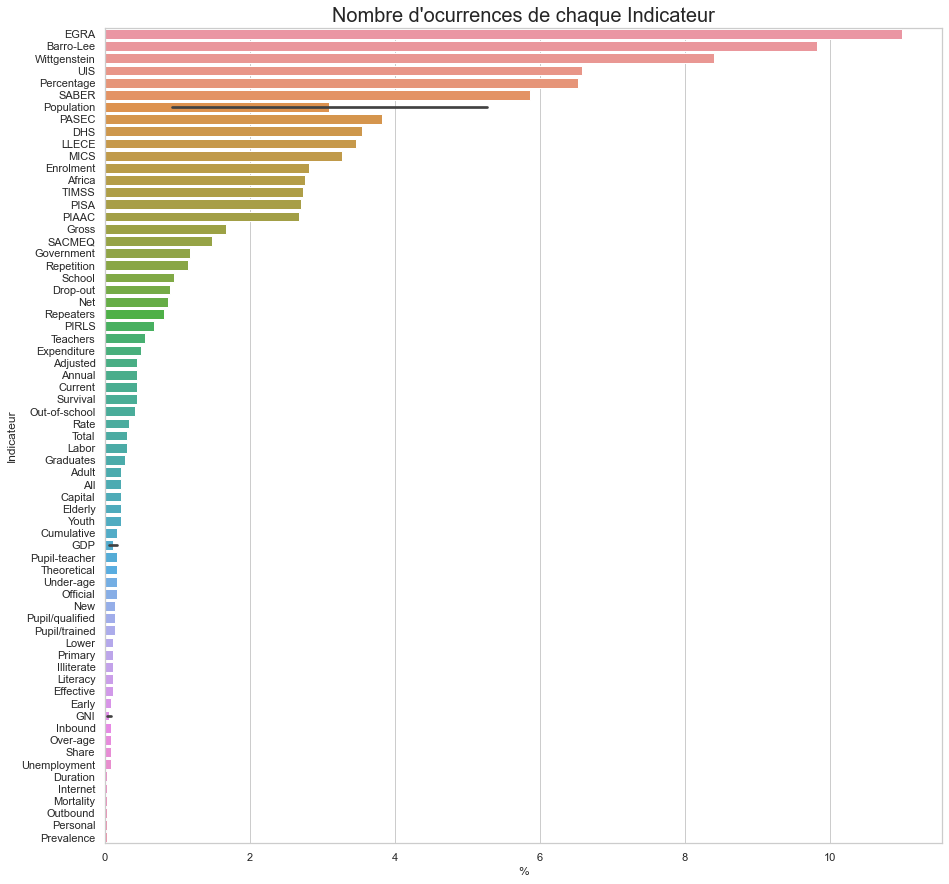

In [82]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,15))
graph = sns.barplot(y='Indicateur',x="%",data=df_indicateursPopulaires)
plt.title("Nombre d'ocurrences de chaque Indicateur",size=20)
plt.show(graph)

Ce que nous pouvons affirmer à partir de l'analyse des occurrences des indicateurs, c'est que la source **EdStatsData.csv** contient principalement des indicateurs liés à l'éducation, même si elle dispose de données, telles que la mortalité et l'emploi.

### EdStatsFootNote.csv

In [83]:
footnote['Year'].sort_values().unique()

array(['1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977',
       '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985',
       '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993',
       '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001',
       '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009',
       '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017',
       '2020', '2025', '2030', '2035', '2040', '2045', '2050'],
      dtype=object)

In [84]:
data_dropped.columns

Index(['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code',
       '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978',
       '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987',
       '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996',
       '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004', '2005',
       '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014',
       '2015', '2016', '2017', '2020', '2025', '2030', '2035', '2040', '2045',
       '2050', '2055', '2060', '2065', '2070', '2075', '2080', '2085', '2090',
       '2095', '2100', 'Unnamed: 69'],
      dtype='object')

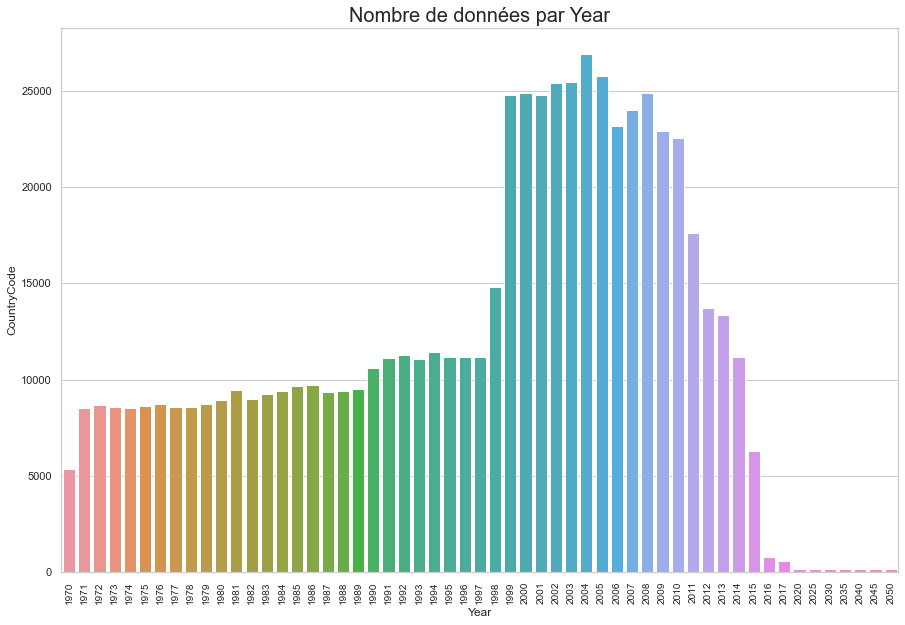

In [85]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,10))
plt.title('Nombre de données par Year',size=20)
plot = sns.barplot(y='CountryCode',x='Year',data=footnote.groupby('Year').count().reset_index())
plot.set_xticklabels(labels = footnote.groupby('Year').count().reset_index()['Year'], rotation=90, size=10)
plt.show()

Pour rendre le traitement des données plus gérable, les années seront regroupées par décennie.

In [86]:
data_group = data_dropped.copy()

In [87]:
data_group['1970s']=data_group[[str(year) for year in range(1970,1980,1)]].mean(axis=1) #start, stop (not included), steps
data_group['1980s']=data_group[[str(year) for year in range(1980,1990,1)]].mean(axis=1)
data_group['1990s']=data_group[[str(year) for year in range(1990,2000,1)]].mean(axis=1)
data_group['2000s']=data_group[[str(year) for year in range(2000,2010,1)]].mean(axis=1)
data_group['2010s']=data_group[[str(year) for year in [2010,2011,2012,2013,2014,2015,2016,2017]]].mean(axis=1)
data_group['2020s']=data_group[[str(year) for year in [2020,2025]]].mean(axis=1)
data_group['2030s']=data_group[[str(year) for year in [2030,2035]]].mean(axis=1)
data_group['2040s']=data_group[[str(year) for year in [2040,2045]]].mean(axis=1)
data_group['2050s']=data_group[[str(year) for year in [2050,2055]]].mean(axis=1)
data_group['2060s']=data_group[[str(year) for year in [2060,2065]]].mean(axis=1)
data_group['2070s']=data_group[[str(year) for year in [2070,2075]]].mean(axis=1)
data_group['2080s']=data_group[[str(year) for year in [2080,2085]]].mean(axis=1)
data_group['2090s']=data_group[[str(year) for year in [2090,2095]]].mean(axis=1)
data_group['2100s']=data_group[[str(year) for year in [2100]]].mean(axis=1)

In [88]:
data_group.drop(['1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977', '1978',
                 '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987',
                 '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996',
                 '1997', '1998', '1999', '2020', '2025', '2030', '2035', '2040', '2045',
                 '2050', '2055', '2060', '2065', '2070', '2075', '2080', '2085', '2090',
                 '2095', '2100','Unnamed: 69'],axis=1,inplace=True)

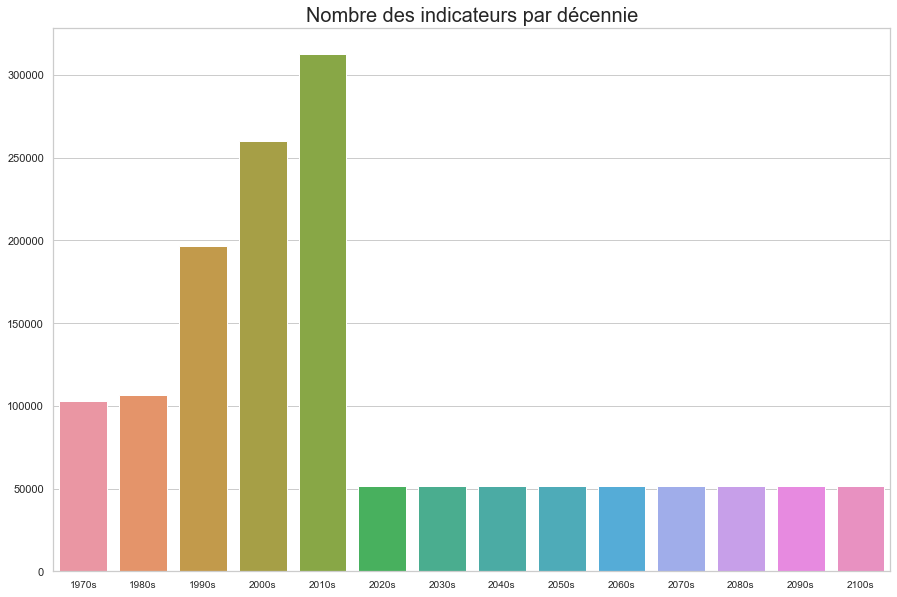

In [89]:
sns.set(style='whitegrid')
plt.figure(figsize=(15,10))
plt.title('Nombre des indicateurs par décennie',size=20)
plot = sns.barplot(y=data_group.shape[0]-data_group[['1970s','1980s','1990s','2000s','2010s','2020s',
                                                    '2030s','2040s','2050s','2060s','2070s','2080s',
                                                     '2090s','2100s']].isna().sum().values,
                   x=data_group[['1970s','1980s','1990s','2000s','2010s','2020s',
                                                    '2030s','2040s','2050s','2060s','2070s','2080s',
                                 '2090s','2100s']].isna().sum().index)
plot.set_xticklabels(labels=['1970s','1980s','1990s','2000s','2010s','2020s',
                                                    '2030s','2040s','2050s','2060s','2070s','2080s',
                             '2090s','2100s'],rotation=0, size=10)
plt.show()

Les décennies de 2000 à 2010 sont celles qui contiennent le plus grand nombre d'indicateurs, l'analyse sera donc basée principalement sur elles.

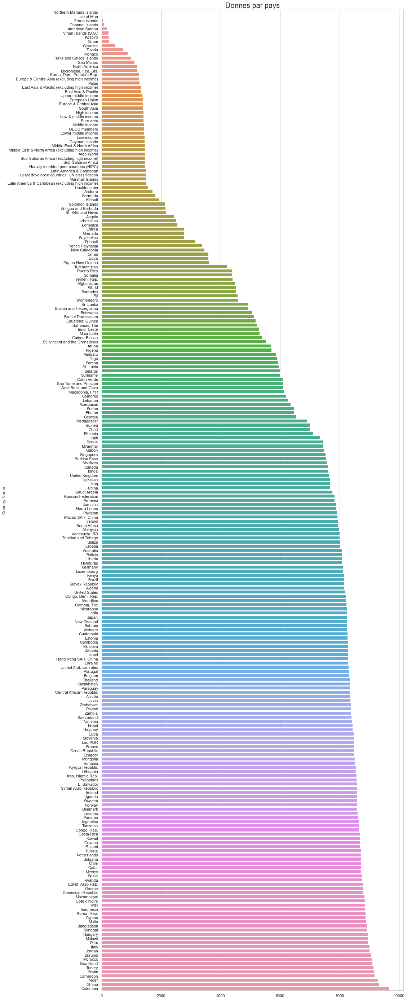

In [90]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,50))
plt.title('Donnes par pays',size=20)
plot = sns.barplot(x=data_group.groupby('Country Name')[['1970s','1980s','1990s','2000s','2010s','2020s',
                                                    '2030s','2040s','2050s','2060s','2070s','2080s',
                                                     '2090s','2100s']].count().sum(axis=1).sort_values().values,
                   y=data_group.groupby('Country Name')[['1970s','1980s','1990s','2000s','2010s','2020s',
                                                    '2030s','2040s','2050s','2060s','2070s','2080s',
                                                     '2090s','2100s']].count().sum(axis=1).sort_values().index)
plt.show()

In [91]:
data_group = data_group.merge(right=country_dropped[['Country Code', 'Region']],on='Country Code',how='left')

In [92]:
data_group.columns

Index(['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code',
       '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008',
       '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017',
       '1970s', '1980s', '1990s', '2000s', '2010s', '2020s', '2030s', '2040s',
       '2050s', '2060s', '2070s', '2080s', '2090s', '2100s', 'Region'],
      dtype='object')

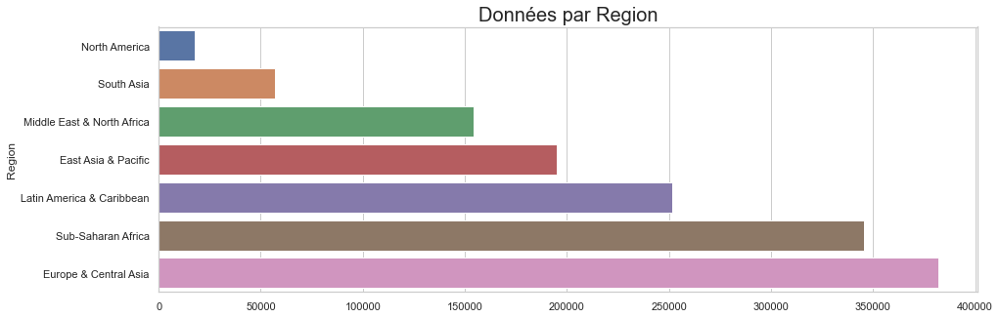

In [93]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,5))
plt.title('Données par Region',size=20)
plot=sns.barplot(x=data_group.groupby('Region')[['1970s','1980s','1990s','2000s','2010s','2020s',
                                         '2030s','2040s','2050s','2060s','2070s','2080s',
                                         '2090s','2100s']].count().sum(axis=1).sort_values().values,
                y=data_group.groupby('Region')[['1970s','1980s','1990s','2000s','2010s','2020s',
                                                '2030s','2040s','2050s','2060s','2070s','2080s',
                                                '2090s','2100s']].count().sum(axis=1).sort_values().index)
plt.show()

Combien de pays contient chaque **Region** ?

In [94]:
#space seulement fonctionnel si le graphique est "h"
def show_values_on_bars(axs, h_v="v", space=0.4):
    def _show_on_single_plot(ax):
        if h_v == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height()
                value = int(p.get_height())
                ax.text(_x, _y, value, ha="center") 
        elif h_v == "h":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() + float(space)
                _y = p.get_y() + p.get_height()
                value = int(p.get_width())
                ax.text(_x, _y, value, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

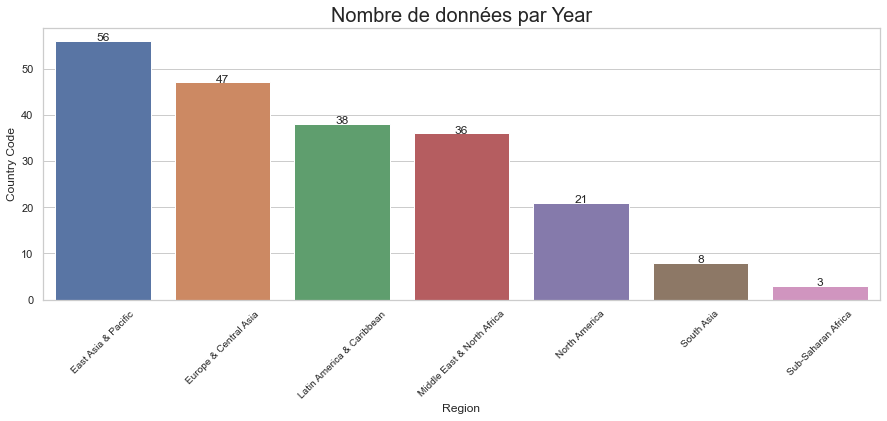

In [95]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,5))
plt.title('Nombre de données par Year',size=20)
plot = sns.barplot(y='Country Code',x='Region',data=country_dropped.groupby('Region').count().reset_index().sort_values(
    by='Country Code',ascending=False))
plot.set_xticklabels(labels = country_dropped.groupby('Region').count().reset_index()['Region'], rotation=45, size=10)
show_values_on_bars(plot,'v',0)
plt.show()

Le nombre de pays par **Region** explique la grande différence de données vue dans le graphique ***Données par Region***

## Détails de pré-analyse

On nettoie les valeurs NA dans les CSV.

In [96]:
country_dropped.isna().sum().sort_values(ascending=False)

Unnamed: 31                                          235
National accounts reference year                     203
Alternative conversion factor                        188
Other groups                                         177
Latest industrial data                               128
Vital registration complete                          126
External debt Reporting status                       111
Latest household survey                               94
Latest agricultural census                            93
Lending category                                      92
Special Notes                                         91
PPP survey year                                       90
Source of most recent Income and expenditure data     76
Government Accounting concept                         74
Latest water withdrawal data                          56
Balance of Payments Manual in use                     54
IMF data dissemination standard                       54
Latest trade data              

In [97]:
country_dropped.shape

(235, 32)

In [98]:
country_dropped.drop(['Unnamed: 31'], axis = 1, inplace = True)

In [99]:
temp = country_dropped.duplicated(keep=False)

In [100]:
countrySeries_dropped.isna().sum().sort_values(ascending=False)

CountryCode    0
SeriesCode     0
DESCRIPTION    0
dtype: int64

In [101]:
temp = countrySeries_dropped.duplicated(keep=False)

In [102]:
data_group.isna().sum().sort_values(ascending=False)

2017              861132
2016              844981
2060s             809839
2070s             809839
2100s             809839
2090s             809839
2050s             809839
2040s             809839
2030s             809839
2020s             809839
2080s             809839
1970s             758371
1980s             754556
2014              748244
2001              738117
2002              737444
2004              732743
2003              731197
2015              730596
2008              727226
2007              724417
2013              724290
2006              721277
2009              719439
2011              715802
2012              714709
2000              684858
2005              677475
1990s             664959
2010              619062
2000s             601060
2010s             548432
Region             95290
Country Code           0
Indicator Code         0
Indicator Name         0
Country Name           0
dtype: int64

In [103]:
temp = data_group.duplicated(keep=False)

In [104]:
footnote.isna().sum().sort_values(ascending=False)

CountryCode    0
SeriesCode     0
Year           0
DESCRIPTION    0
dtype: int64

In [105]:
temp = footnote.duplicated(keep=False)

In [106]:
series.isna().sum().sort_values(ascending=False)

License Type                           3665
Notes from original source             3665
Related indicators                     3665
Other web links                        3665
Unit of measure                        3665
Development relevance                  3662
General comments                       3651
Limitations and exceptions             3651
Statistical concept and methodology    3642
Aggregation method                     3618
Periodicity                            3566
Related source links                   3450
Base Period                            3351
Other notes                            3113
Short definition                       1509
Topic                                     0
Source                                    0
Long definition                           0
Indicator Name                            0
Series Code                               0
dtype: int64

In [107]:
temp = series.duplicated(keep=False)

In [108]:
csvFiles = [['country_dropped',country_dropped.shape,'EdStatsCountry.csv'],
            ['countrySeries_dropped',countrySeries_dropped.shape,'EdStatsCountry-Series.csv'],
            ['data_group',data_group.shape,'EdStatsData.csv'],
            ['footnote',footnote.shape,'EdStatsFootNote.csv'],
            ['series',series.shape,'EdStatsSeries.csv']]
csvFiles = pd.DataFrame(csvFiles, columns=['DF Name','Shape','csv File'])
print('DataFrames utilisés :')
csvFiles

DataFrames utilisés :


,DF Name,Shape,csv File
0,country_dropped,"(235, 31)",EdStatsCountry.csv
1,countrySeries_dropped,"(611, 3)",EdStatsCountry-Series.csv
2,data_group,"(861275, 37)",EdStatsData.csv
3,footnote,"(640753, 4)",EdStatsFootNote.csv
4,series,"(3665, 20)",EdStatsSeries.csv


### Bilan de la pré-analyse


Questions à répondre :
- Valider la qualité de ce jeu de données (comporte-t-il beaucoup de données manquantes, dupliquées ?)
- Décrire les informations contenues dans le jeu de données (nombre de colonnes ? nombre de lignes ?)


#### csv Files :
- **EdStatsCountry.csv** contient des informations globales sur l'économie de chaque élément dans la liste (qui contient des pays et des régions). 235 lignes et 31 colonnes.
- **StatsCountry-Series.csv** contient la source des données contenues dans **EdStatsCountry.csv**. 611 lignes et 3 colonnes.
- **EdStatsData.csv** contient 3665 indicateurs uniques (principalement des indicateurs liés à l'éducation, même si le fichier dispose de données telles que la mortalité et l'emploi) pour chaque élément dans la liste du fichier **EdStatsCountry.csv**. La plage de valeurs va de 1970 à 2100. 861275 lignes et 37 colonnes.
- **EdStatsFootNote.csv** fournit des informations sur l'année d'origine des données. 640753 lignes et 4 colonnes.
- **EdStatsSeries.csv** contient des détails descriptifs des 3665 indicateurs présents dans le fichier **EdStatsData.csv** mais il y a des données manquantes. 3665 lignes et 20 colonnes.


#### Composition des données :
- Il s'agit principalement d'indicateurs liés à l'éducation, bien que des indicateurs économiques soient également disponibles.
- Comme détaillé précédemment, l'analyse sera effectuée sur 235 codes de pays/région contenus dans le fichier **EdStatsCountry.csv**.
    - 235 éléments présents dont 35 sont des régions composées de pays ou de territoires spéciaux.
- Les données contenues dans le fichier **EdStatsData.csv** sont groupées par décennie et une colonne contenant les identifiants de **Region** a été ajoutée.
- Les dupliquées ont été supprimés de tous les DataFrames utilisés.
- Les colonnes appelées *Unnamed* dans tous les DataFrames ont été éliminées car elles étaient composées par *NA*.
- Tous les DataFrames ont des valeurs manquantes (en plus des colonnes *Unnamed*).
    - **EdStatsData.csv** a exactement la même quantité de valeurs manquantes pour toutes les années après 2017.
    - **EdStatsSeries.csv** contient 5 colonnes vides (en plus de *Unnamed*). C'est possible de les supprimer si nécessaire.

    
#### Dans la suite de la pré-analyse, on répond aux questions suivantes :
- Sélectionner les informations qui semblent pertinentes pour répondre à la problématique (quelles sont les colonnes contenant des informations qui peuvent être utiles pour répondre à la problématique de l’entreprise ?)
- Déterminer des ordres de grandeurs des indicateurs statistiques classiques pour les différentes zones géographiques et pays du monde (moyenne/médiane/écart-type par pays et par continent ou bloc géographique)

In [109]:
data_group.columns

Index(['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code',
       '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008',
       '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017',
       '1970s', '1980s', '1990s', '2000s', '2010s', '2020s', '2030s', '2040s',
       '2050s', '2060s', '2070s', '2080s', '2090s', '2100s', 'Region'],
      dtype='object')

On peut laisser de côté les colonnes avec des données "futures".

In [114]:
data_group_ppNoF = data_group[['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code',
                               '2000', '2001', '2002', '2003', '2004', '2005','2006', '2007','2008',
                               '2009', '2010', '2011', '2012', '2013', '2014','2015', '2016', '2017',
                               '1970s', '1980s', '1990s', '2000s', '2010s','Region']] #ppNoF : Past, Present, No Future

Quelles sont les informations pertinentes pour répondre à la problématique ?

In [115]:
show_ppNoF = data_group_ppNoF[['Indicator Name','1970s', '1980s', '1990s', '2000s', '2010s']].groupby('Indicator Name').count().sort_values(by='2010s',ascending=False)

In [116]:
show_ppNoF.sample(10)

,1970s,1980s,1990s,2000s,2010s
Indicator Name,,,,,
LLECE: Distribution of 4th Grade Mathematics Scores: 10th Percentile Score,0,0,12,0,0
Wittgenstein Projection: Population age 15-19 in thousands by highest level of educational attainment. Primary. Female,0,0,0,0,167
LLECE: Female 6th grade students by mathematics proficiency level (%). Level 2,0,0,0,16,0
PIRLS: Distribution of Reading Scores: 5th Percentile Score,0,0,0,42,49
"Adjusted net intake rate to Grade 1 of primary education, female (%)",113,128,173,191,189
DHS: Transition rate. Primary to Secondary. Quintile 5,0,0,1,46,9
"UIS: Net attendance rate, lower secondary, male (%)",0,0,0,70,41
TIMSS: Male 4th grade students reaching the low international benchmark of mathematics achievement (%),0,0,24,37,46
MICS: Typology of out-of-school children. Primary. Late entry. Rural,0,0,0,13,19


In [117]:
show_ppNoF = data_group_ppNoF[['Indicator Name','2000', '2001', '2002', '2003', '2004', '2005','2006', '2007','2008','2009',
                               '2010', '2011', '2012', '2013','2014','2015','2016','2017']].groupby('Indicator Name').count().sort_values(by='2010',ascending=False)

In [118]:
show_ppNoF.sample(10)

,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
Indicator Name,,,,,,,,,,,,,,,,,,
Wittgenstein Projection: Percentage of the population age 20-24 by highest level of educational attainment. Incomplete Primary. Total,0,0,0,0,0,0,0,0,0,0,167,0,0,0,0,167,0,0
Wittgenstein Projection: Percentage of the population age 25-29 by highest level of educational attainment. No Education. Male,0,0,0,0,0,0,0,0,0,0,167,0,0,0,0,167,0,0
"Graduates from ISCED 7 programmes in tertiary education, female (number)",0,0,0,0,0,0,0,0,0,0,2,2,10,71,73,3,0,0
Wittgenstein Projection: Percentage of the population age 15+ by highest level of educational attainment. Post Secondary. Male,0,0,0,0,0,0,0,0,0,0,167,0,0,0,0,167,0,0
LLECE: 3rd grade students by mathematics proficiency level (%). Below Level 1,0,0,0,0,0,0,16,0,0,0,0,0,0,15,0,0,0,0
"Population, female (% of total)",217,217,217,217,217,217,217,217,217,217,217,217,216,216,213,213,213,0
"Drop-out rate from Grade 5 of primary education, female (%)",50,60,55,50,58,50,53,59,67,64,57,55,59,45,0,0,0,0
"Population, ages 13-17, male",190,191,192,192,191,191,187,181,181,181,181,181,181,181,181,181,0,0
LLECE: Distribution of 6th Grade Science Scores: 90th Percentile Score,0,0,0,0,0,0,9,0,0,0,0,0,0,0,0,0,0,0


In [119]:
show_ppNoF = data_group_ppNoF[['Indicator Code','1970s', '1980s', '1990s', '2000s', '2010s']].groupby('Indicator Code').count().sort_values(by='2010s',ascending=False)

In [120]:
show_ppNoF.sample(10)

,1970s,1980s,1990s,2000s,2010s
Indicator Code,,,,,
PRJ.MYS.80UP.MA,0,0,0,0,167
LO.EGRA.ORF.HAR.3GRD,0,0,0,0,1
PRJ.ATT.2529.1.FE,0,0,0,0,167
LO.PISA.SCI.5,0,0,0,70,73
UIS.FOSEP.56.F500.M,0,0,50,107,128
UIS.AFR.TATTRR.3.Pu.T,0,0,0,0,1
UIS.ROFST.H.2.Q4.F,0,0,0,69,41
LO.TIMSS.SCI8.P95,0,0,35,57,45
LO.TIMSS.MAT8.INT.FE,0,0,49,57,40


Quelle est la répartition de données par indicateur ?

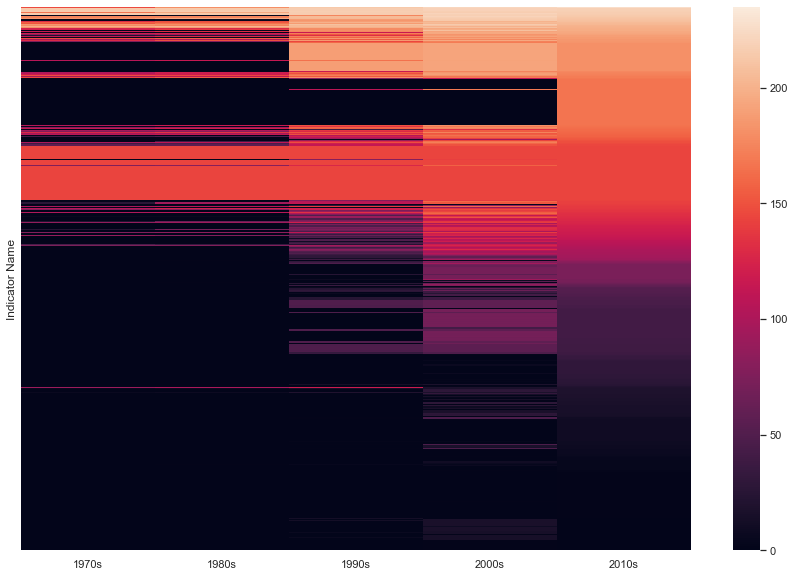

In [121]:
heatData=data_group_ppNoF[['Indicator Name','1970s','1980s','1990s','2000s','2010s']].groupby('Indicator Name').count().sort_values(by='2010s',ascending=False)
plt.figure(figsize=(15,10))
sns.heatmap(heatData,yticklabels=False)
plt.show()

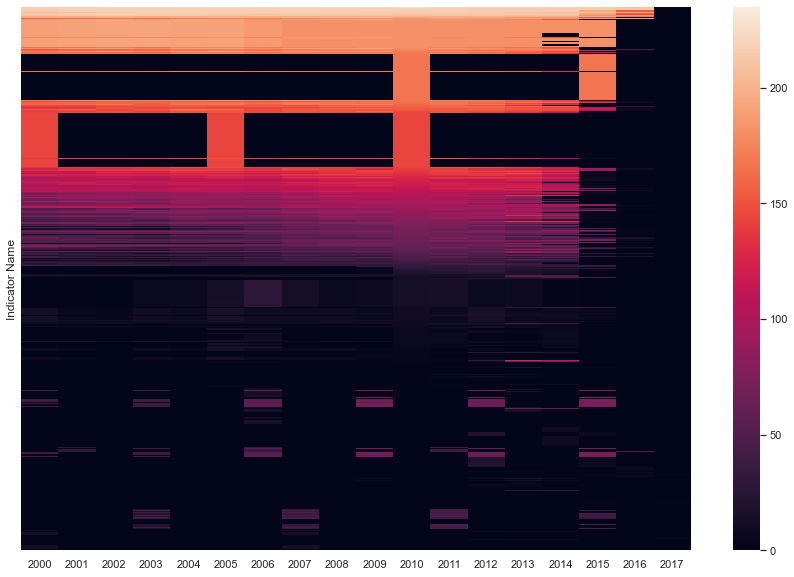

In [122]:
heatData=data_group_ppNoF[['Indicator Name','2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                           '2010','2011','2012','2013','2014','2015','2016',
                           '2017']].groupby('Indicator Name').count().sort_values(by='2010',ascending=False)
plt.figure(figsize=(15,10))
sns.heatmap(heatData,yticklabels=False)
plt.show()

In [123]:
data_group_ppNoF.isna().sum().sort_values(ascending=True)

Country Name           0
Country Code           0
Indicator Name         0
Indicator Code         0
Region             95290
2010s             548432
2000s             601060
2010              619062
1990s             664959
2005              677475
2000              684858
2012              714709
2011              715802
2009              719439
2006              721277
2013              724290
2007              724417
2008              727226
2015              730596
2003              731197
2004              732743
2002              737444
2001              738117
2014              748244
1980s             754556
1970s             758371
2016              844981
2017              861132
dtype: int64

Comme détaillé dans la HeatMap et la liste, les décennies de 1970 et 1980 sont celles qui contiennent (pour le même indicateur) le moins de données. Il en va de même pour la décenie de 1990. Par conséquent, pour l'analyse, nous utiliserons les années 2000-2017 car il s'agit des décennies les plus détaillées. Il faut prendre en compte le fait que les années 2016 et 2017 sont practiquement vides.

In [124]:
data_group_ppNoF.drop(['1970s','1980s','1990s'], axis = 1, inplace = True)

In [125]:
df_temp = data_group_ppNoF.copy()
df_temp.shape

(861275, 25)

Quels sont les groupes d'indicateurs avec la plus grande et la plus petite quantité de données ?

In [126]:
prefix = [i.split('.',1)[0] for i in df_temp['Indicator Code'].tolist()]
prefixPop = collections.Counter(prefix).most_common() #Tous les événements dans le compteur
prefixPop

[('UIS', 246045),
 ('LO', 245810),
 ('BAR', 84600),
 ('PRJ', 72380),
 ('HH', 58750),
 ('SP', 50525),
 ('SABER', 50525),
 ('SE', 40655),
 ('SL', 3995),
 ('OECD', 3760),
 ('NY', 2820),
 ('XGDP', 470),
 ('IT', 470),
 ('SH', 470)]

Taux de remplissage = pays sans NaN / 235 * 100

235 = quantité de pays/régions

In [127]:
df_temp.groupby(by=['Country Name'], dropna=True).count()

,Country Code,Indicator Name,Indicator Code,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2000s,2010s,Region
Country Name,,,,,,,,,,,,,,,,,,,,,,,,
Afghanistan,3665,3665,3665,612,294,293,419,373,741,321,411,375,429,761,682,434,446,543,352,43,23,865,1256,3665
Albania,3665,3665,3665,1130,705,361,626,537,864,518,574,849,937,1347,872,926,890,693,797,68,0,1708,1822,3665
Algeria,3665,3665,3665,1002,632,665,664,656,1051,764,809,691,682,1366,689,541,538,492,730,43,0,1328,1547,3665
American Samoa,3665,3665,3665,4,4,8,8,8,8,10,16,8,8,8,8,8,8,8,8,8,0,18,8,3665
Andorra,3665,3665,3665,200,199,417,398,449,449,571,349,373,346,349,326,373,454,430,156,50,0,663,607,3665
Angola,3665,3665,3665,333,359,402,282,265,290,324,329,649,650,586,576,253,329,235,263,68,0,809,737,3665
Antigua and Barbuda,3665,3665,3665,277,265,297,257,257,257,257,307,413,610,554,532,551,76,448,168,71,0,907,669,3665
Arab World,3665,3665,3665,331,331,337,337,343,346,348,347,347,342,342,339,362,366,310,1,0,0,352,370,0
Argentina,3665,3665,3665,1141,864,776,827,784,1162,1059,848,860,940,1520,839,919,811,316,690,72,0,1559,1720,3665


In [128]:
tRemplissage_pays=df_temp.groupby(by=['Country Name'], dropna=True).count().div(3365).multiply(100)

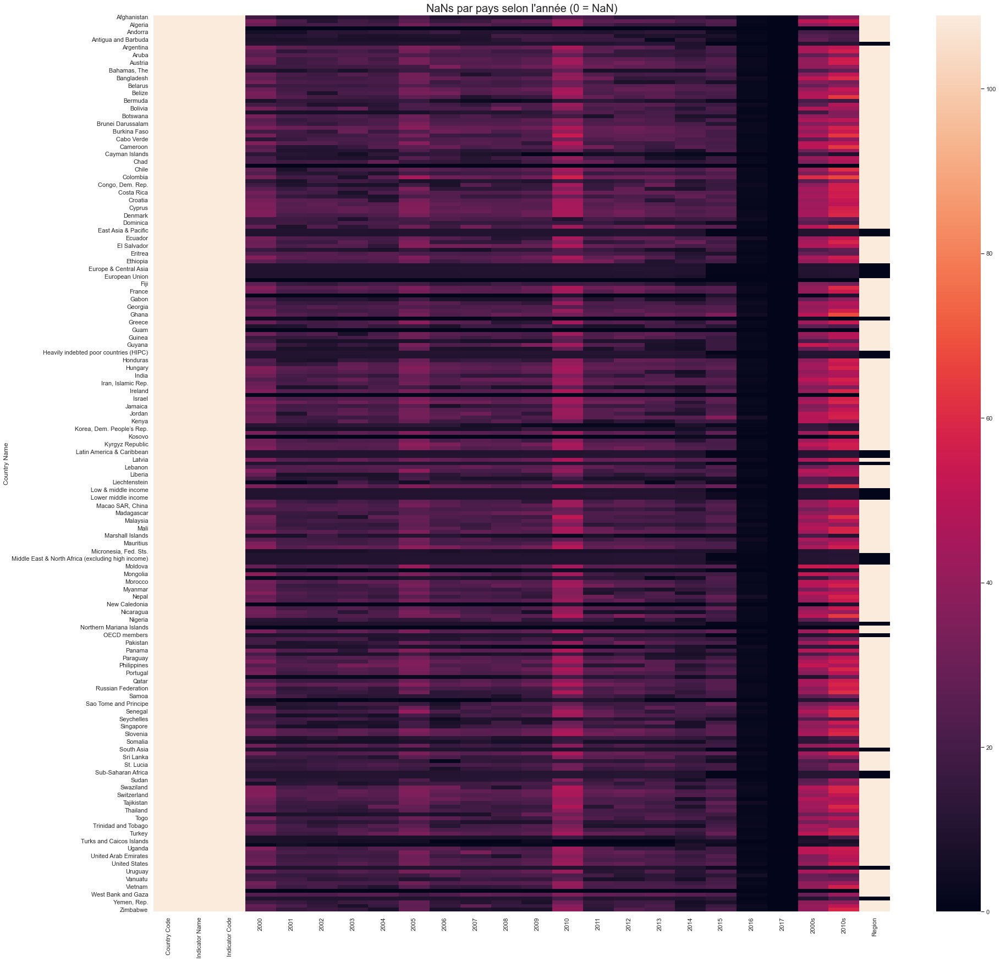

In [129]:
plt.figure(figsize=(30,30))
plt.title("NaNs par pays selon l'année (0 = NaN)",size=20)
sns.heatmap(tRemplissage_pays)
plt.show()

In [130]:
df_temp.groupby(by=['Indicator Name'], dropna=True).count()

,Country Name,Country Code,Indicator Code,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2000s,2010s,Region
Indicator Name,,,,,,,,,,,,,,,,,,,,,,,,
"Adjusted net enrolment rate, lower secondary, both sexes (%)",235,235,235,95,101,101,94,101,105,98,104,102,112,106,107,101,99,84,3,0,0,154,146,209
"Adjusted net enrolment rate, lower secondary, female (%)",235,235,235,93,95,96,89,97,101,95,101,100,110,103,106,100,98,83,3,0,0,150,145,209
"Adjusted net enrolment rate, lower secondary, gender parity index (GPI)",235,235,235,93,95,96,89,97,101,95,101,100,110,103,106,100,98,83,3,0,0,150,145,209
"Adjusted net enrolment rate, lower secondary, male (%)",235,235,235,93,95,96,89,97,101,95,101,100,110,103,106,100,98,83,3,0,0,150,145,209
"Adjusted net enrolment rate, primary, both sexes (%)",235,235,235,148,141,149,148,147,157,150,157,157,163,156,156,160,152,154,118,9,0,195,198,209
"Adjusted net enrolment rate, primary, female (%)",235,235,235,131,121,122,128,129,137,137,143,144,148,140,144,145,143,145,109,9,0,186,189,209
"Adjusted net enrolment rate, primary, gender parity index (GPI)",235,235,235,128,118,119,125,126,135,136,142,142,144,135,139,140,130,119,7,0,0,183,179,209
"Adjusted net enrolment rate, primary, male (%)",235,235,235,131,121,122,128,129,137,137,143,144,148,140,144,145,143,145,109,9,0,186,189,209
"Adjusted net enrolment rate, upper secondary, both sexes (%)",235,235,235,33,25,32,33,39,37,40,42,46,56,57,57,52,100,89,3,0,0,86,139,209


In [131]:
df_temp.groupby(by=['Indicator Name'], dropna=True).count().div(235).multiply(100)

,Country Name,Country Code,Indicator Code,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2000s,2010s,Region
Indicator Name,,,,,,,,,,,,,,,,,,,,,,,,
"Adjusted net enrolment rate, lower secondary, both sexes (%)",100.0,100.0,100.0,40.425532,42.978723,42.978723,40.000000,42.978723,44.680851,41.702128,44.255319,43.404255,47.659574,45.106383,45.531915,42.978723,42.127660,35.744681,1.276596,0.000000,0.000000,65.531915,62.127660,88.93617
"Adjusted net enrolment rate, lower secondary, female (%)",100.0,100.0,100.0,39.574468,40.425532,40.851064,37.872340,41.276596,42.978723,40.425532,42.978723,42.553191,46.808511,43.829787,45.106383,42.553191,41.702128,35.319149,1.276596,0.000000,0.000000,63.829787,61.702128,88.93617
"Adjusted net enrolment rate, lower secondary, gender parity index (GPI)",100.0,100.0,100.0,39.574468,40.425532,40.851064,37.872340,41.276596,42.978723,40.425532,42.978723,42.553191,46.808511,43.829787,45.106383,42.553191,41.702128,35.319149,1.276596,0.000000,0.000000,63.829787,61.702128,88.93617
"Adjusted net enrolment rate, lower secondary, male (%)",100.0,100.0,100.0,39.574468,40.425532,40.851064,37.872340,41.276596,42.978723,40.425532,42.978723,42.553191,46.808511,43.829787,45.106383,42.553191,41.702128,35.319149,1.276596,0.000000,0.000000,63.829787,61.702128,88.93617
"Adjusted net enrolment rate, primary, both sexes (%)",100.0,100.0,100.0,62.978723,60.000000,63.404255,62.978723,62.553191,66.808511,63.829787,66.808511,66.808511,69.361702,66.382979,66.382979,68.085106,64.680851,65.531915,50.212766,3.829787,0.000000,82.978723,84.255319,88.93617
"Adjusted net enrolment rate, primary, female (%)",100.0,100.0,100.0,55.744681,51.489362,51.914894,54.468085,54.893617,58.297872,58.297872,60.851064,61.276596,62.978723,59.574468,61.276596,61.702128,60.851064,61.702128,46.382979,3.829787,0.000000,79.148936,80.425532,88.93617
"Adjusted net enrolment rate, primary, gender parity index (GPI)",100.0,100.0,100.0,54.468085,50.212766,50.638298,53.191489,53.617021,57.446809,57.872340,60.425532,60.425532,61.276596,57.446809,59.148936,59.574468,55.319149,50.638298,2.978723,0.000000,0.000000,77.872340,76.170213,88.93617
"Adjusted net enrolment rate, primary, male (%)",100.0,100.0,100.0,55.744681,51.489362,51.914894,54.468085,54.893617,58.297872,58.297872,60.851064,61.276596,62.978723,59.574468,61.276596,61.702128,60.851064,61.702128,46.382979,3.829787,0.000000,79.148936,80.425532,88.93617
"Adjusted net enrolment rate, upper secondary, both sexes (%)",100.0,100.0,100.0,14.042553,10.638298,13.617021,14.042553,16.595745,15.744681,17.021277,17.872340,19.574468,23.829787,24.255319,24.255319,22.127660,42.553191,37.872340,1.276596,0.000000,0.000000,36.595745,59.148936,88.93617


In [132]:
tRemplissage=df_temp.groupby(by=['Indicator Name'], dropna=True).count().div(235).multiply(100)

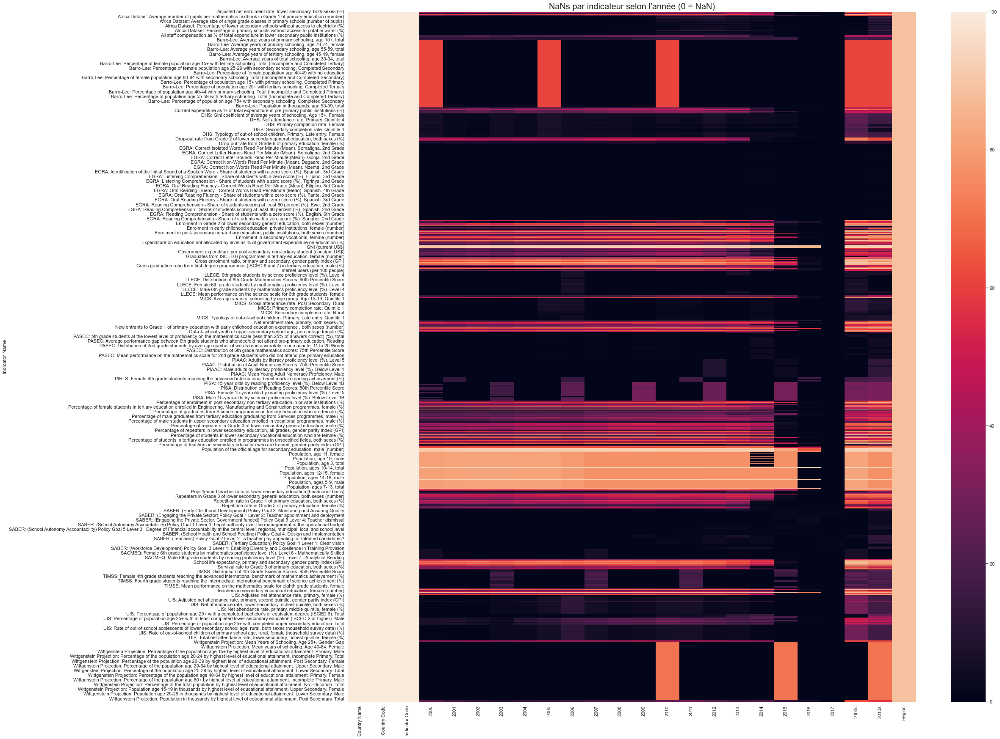

In [133]:
plt.figure(figsize=(30,30))
plt.title("NaNs par indicateur selon l'année (0 = NaN)",size=20)
sns.heatmap(tRemplissage)
plt.show()

3665 indicateurs sont trop nombreux pour être affichés lisiblement. On vérifie si la lisibilité s'améliore par *Code*.

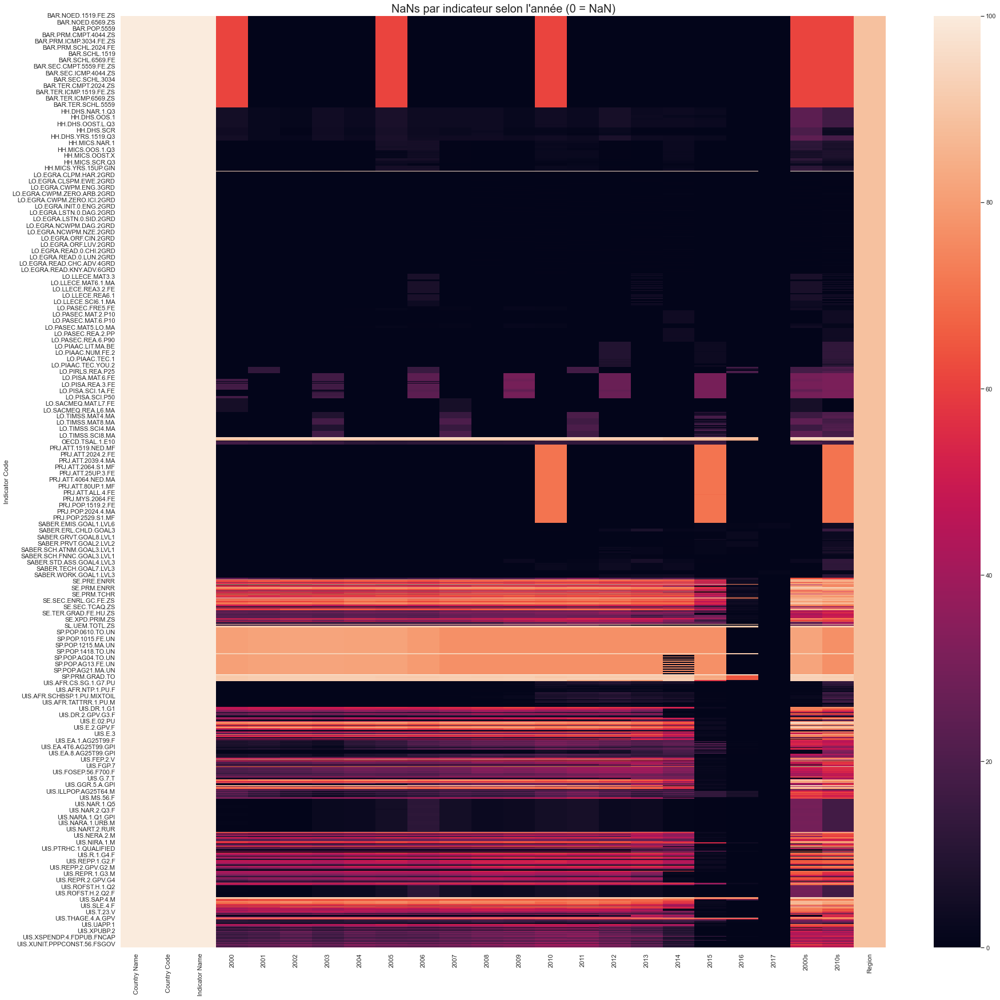

In [134]:
tRemplissageCode=df_temp.groupby(by=['Indicator Code'], dropna=True).count().div(235).multiply(100)
plt.figure(figsize=(30,30))
plt.title("NaNs par indicateur selon l'année (0 = NaN)",size=20)
sns.heatmap(tRemplissageCode)
plt.show()

In [135]:
df_temp.shape

(861275, 25)

Quels indicateurs va-t-on retenir ?

On va conserver les indicateurs qui ont plus de 20% de taux de remplissage séparément pour les régions (35) et pour les pays (200).

In [136]:
df_Reduced = df_temp.copy()

In [137]:
df_tRemplissage=df_Reduced.groupby(by=['Indicator Name'], dropna=True).count().div(235).multiply(100).reset_index()
df_tRemplissage.shape

(3665, 25)

In [138]:
df_tRemplissage['2000s']=df_tRemplissage[[str(year) for year in range(2000,2010,1)]].mean(axis=1,skipna=False)
df_tRemplissage['2010s']=df_tRemplissage[[str(year) for year in [2010,2011,2012,2013,2014,2015,2016,2017]]].mean(axis=1,skipna=False)

In [139]:
indexDel = df_tRemplissage[(df_tRemplissage['2000s'] < 20) & (df_tRemplissage['2010s'] < 20)].index

In [140]:
df_tRemplissage.drop(indexDel,inplace=True)
df_tRemplissage.shape

(930, 25)

In [141]:
df_tRemplissage.drop(['Country Name','Country Code','Indicator Code','Region'], axis = 1, inplace = True)

In [142]:
temp = df_tRemplissage['Indicator Name'].unique().tolist()
print('Inidcateurs à conserver :',len(temp))
print('Indicateurs originaux :',len(df_Reduced['Indicator Code'].unique()))
print('Proportion conservée :',round(len(temp)/(len(df_temp['Indicator Code'].unique()))*100),'%')

Inidcateurs à conserver : 930
Indicateurs originaux : 3665
Proportion conservée : 25 %


[]

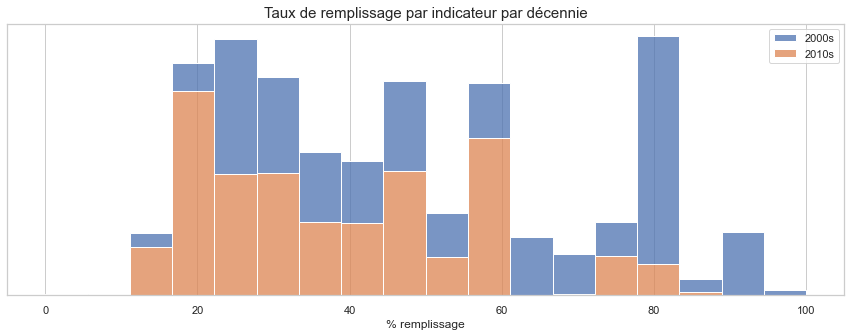

In [143]:
plt.figure(figsize=(15,5))
plt.title('Taux de remplissage par indicateur par décennie', size=15)
plt.xlabel('% remplissage')
ax = plt.gca()
ax.set_yticks([])
sns.histplot(df_tRemplissage[['2000s','2010s']],multiple='stack')
plt.plot()

In [144]:
cond = ~df_temp['Indicator Name'].isin(df_tRemplissage['Indicator Name'])
df_Reduced.drop(df_temp[cond].index,inplace=True)

In [145]:
print(df_Reduced.shape)
print(len(df_Reduced['Indicator Name'].unique()))

(218550, 25)
930


In [146]:
print(df_Reduced['Indicator Name'].unique())

['Adjusted net enrolment rate, lower secondary, both sexes (%)'
 'Adjusted net enrolment rate, lower secondary, female (%)'
 'Adjusted net enrolment rate, lower secondary, gender parity index (GPI)'
 'Adjusted net enrolment rate, lower secondary, male (%)'
 'Adjusted net enrolment rate, primary, both sexes (%)'
 'Adjusted net enrolment rate, primary, female (%)'
 'Adjusted net enrolment rate, primary, gender parity index (GPI)'
 'Adjusted net enrolment rate, primary, male (%)'
 'Adjusted net intake rate to Grade 1 of primary education, both sexes (%)'
 'Adjusted net intake rate to Grade 1 of primary education, female (%)'
 'Adjusted net intake rate to Grade 1 of primary education, gender parity index (GPI)'
 'Adjusted net intake rate to Grade 1 of primary education, male (%)'
 'All staff compensation as % of total expenditure in pre-primary public institutions (%)'
 'All staff compensation as % of total expenditure in primary public institutions (%)'
 'All staff compensation as % of to

In [147]:
print(df_Reduced['Indicator Code'].unique())

['UIS.NERA.2' 'UIS.NERA.2.F' 'UIS.NERA.2.GPI' 'UIS.NERA.2.M' 'SE.PRM.TENR'
 'SE.PRM.TENR.FE' 'UIS.NERA.1.GPI' 'SE.PRM.TENR.MA' 'UIS.NIRA.1'
 'UIS.NIRA.1.F' 'UIS.NIRA.1.GPI' 'UIS.NIRA.1.M' 'UIS.XSPENDP.0.FDPUB.FNS'
 'UIS.XSPENDP.1.FDPUB.FNS' 'UIS.XSPENDP.FDPUB.FNS'
 'UIS.XSPENDP.23.FDPUB.FNS' 'UIS.XSPENDP.56.FDPUB.FNS'
 'UIS.XSPENDP.3.FDPUB.FNS' 'UIS.XSPENDP.0.FDPUB.FNCAP'
 'UIS.XSPENDP.1.FDPUB.FNCAP' 'UIS.XSPENDP.FDPUB.FNCAP'
 'UIS.XSPENDP.23.FDPUB.FNCAP' 'UIS.XSPENDP.56.FDPUB.FNCAP'
 'UIS.XSPENDP.3.FDPUB.FNCAP' 'UIS.DR.2.GPV.T' 'UIS.DR.2.GPV.F'
 'UIS.DR.2.GPV.M' 'SE.PRM.DROP.ZS' 'SE.PRM.DROP.FE.ZS' 'SE.PRM.DROP.MA.ZS'
 'UIS.XSPENDP.2.FDPUB.FNCUR' 'UIS.XSPENDP.0.FDPUB.FNCUR'
 'UIS.XSPENDP.1.FDPUB.FNCUR' 'SE.XPD.CUR.TOTL.ZS'
 'UIS.XSPENDP.23.FDPUB.FNCUR' 'UIS.XSPENDP.56.FDPUB.FNCUR'
 'UIS.XSPENDP.3.FDPUB.FNCUR' 'UIS.XSPENDP.0.FDPUB.FNNONS'
 'UIS.XSPENDP.1.FDPUB.FNNONS' 'UIS.XSPENDP.FDPUB.FNNONS'
 'UIS.XSPENDP.23.FDPUB.FNNONS' 'UIS.XSPENDP.56.FDPUB.FNNONS'
 'UIS.XSPENDP.3.FDPUB.FNNONS' '

In [148]:
prefix = [i.split('.',1)[0] for i in df_Reduced['Indicator Code'].tolist()]
prefixPop = collections.Counter(prefix).most_common() #Tous les événements dans le compteur
prefixPop

[('UIS', 122435),
 ('SP', 50525),
 ('SE', 38070),
 ('SL', 3290),
 ('NY', 2820),
 ('XGDP', 470),
 ('IT', 470),
 ('SH', 470)]

**Quelles sont les indicateurs disponibles ?**

http://datatopics.worldbank.org/education/indicators

http://uis.unesco.org/en/glossary

Quelles informations semblent pertinentes pour répondre à la problématique ?

S'agissant d'une plateforme *EdTech*, les principaux indicateurs doivent être liés à l'éducation (niveau et dépenses) et à l'accès à Internet, ainsi que les indicateurs démographiques. De plus, les indicateurs doivent être analysés par zone et pays/région spéciale et sans différencier les hommes et les femmes.

**Education**
- UIS.E.5.B : Enrolment in tertiary education, ISCED 5 programmes, both sexes (number)
- UIS.E.4 : Enrolment in post-secondary non-tertiary education, both sexes (number)
- UIS.E.3 : Enrolment in upper secondary education, both sexes (number)
- SE.TER.ENRL : Enrolment in tertiary education, all programs, both sexes (number)

**Démographique**
- SP.POP.GROW : Population growth (annual %)
- SP.POP.1524.TO.UN : Population, ages 15-24, total

**Dépenses**
- SE.XPD.TOTL.GB.ZS : Expenditure on education as % of total government expenditure (%)

**Internet**
- IT.NET.USER.P2 : Internet users (per 100 people)
- IT.CMP.PCMP.P2 : Personal computers (per 100 people)

**PIB**
- NY.GDP.PCAP.CD : GDP per capita (current USD)
- NY.GDP.PCAP.PP.CD : GDP per capita, PPP (current international USD)

In [149]:
indicateurs = ['UIS.E.5.B',
               'UIS.E.4',
               'UIS.E.3',
               'SE.TER.ENRL',
               'SP.POP.GROW',
               'SP.POP.1524.TO.UN',
               'SE.XPD.TOTL.GB.ZS',
               'IT.NET.USER.P2',
               'IT.CMP.PCMP.P2',
               'NY.GDP.PCAP.CD',
               'NY.GDP.PCAP.PP.CD',]

In [150]:
df_Reduced[df_Reduced['Indicator Code'].isin(indicateurs)][['Indicator Name','Indicator Code','2000s','2010s']].groupby(['Indicator Name','Indicator Code']).count().reset_index()

,Indicator Name,Indicator Code,2000s,2010s
0,"Enrolment in post-secondary non-tertiary education, both sexes (number)",UIS.E.4,151,136
1,"Enrolment in tertiary education, ISCED 5 programmes, both sexes (number)",UIS.E.5.B,171,160
2,"Enrolment in tertiary education, all programmes, both sexes (number)",SE.TER.ENRL,209,194
3,"Enrolment in upper secondary education, both sexes (number)",UIS.E.3,216,203
4,Expenditure on education as % of total government expenditure (%),SE.XPD.TOTL.GB.ZS,166,148
5,GDP per capita (current US$),NY.GDP.PCAP.CD,231,227
6,"GDP per capita, PPP (current international $)",NY.GDP.PCAP.PP.CD,214,216
7,Internet users (per 100 people),IT.NET.USER.P2,229,228
8,Personal computers (per 100 people),IT.CMP.PCMP.P2,216,0
9,Population growth (annual %),SP.POP.GROW,235,235


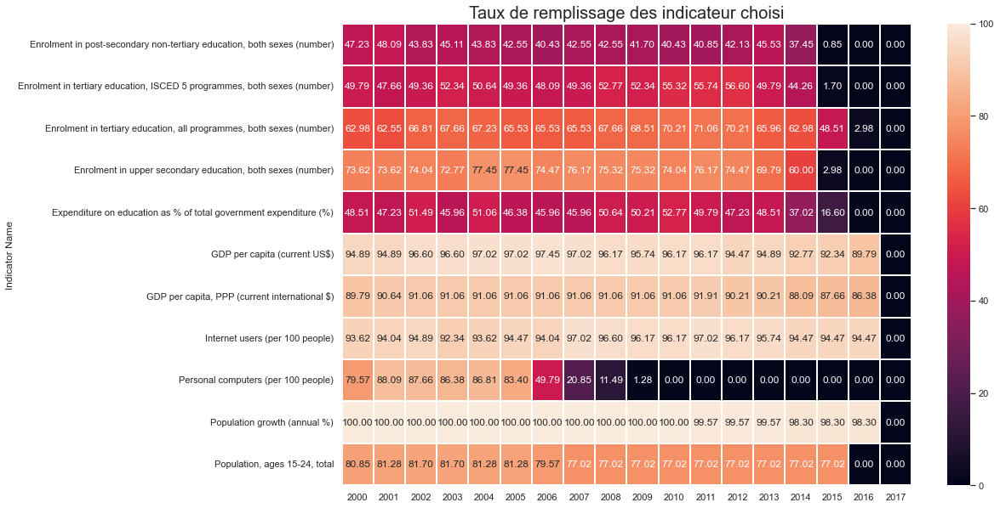

In [151]:
search=df_Reduced[df_Reduced['Indicator Code'].isin(indicateurs)][['Indicator Name','2000','2001','2002','2003','2004','2005','2006','2007','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017']].groupby(['Indicator Name']).count().div(235).multiply(100)
plt.figure(figsize=(15,10))
plt.title("Taux de remplissage des indicateur choisi",size=20)
sns.heatmap(search,annot=True,fmt='.2f',linewidths=.3)
plt.show()

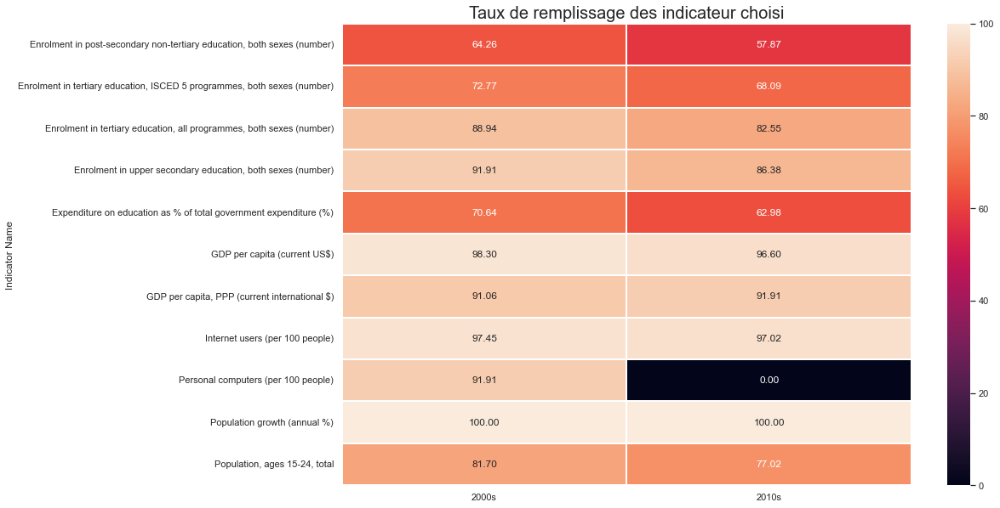

In [152]:
search=df_Reduced[df_Reduced['Indicator Code'].isin(indicateurs)][['Indicator Name','2000s','2010s']].groupby(['Indicator Name']).count().div(235).multiply(100)
plt.figure(figsize=(15,10))
plt.title("Taux de remplissage des indicateur choisi",size=20)
sns.heatmap(search,annot=True,fmt='.2f',linewidths=.3)
plt.show()

**IT.CMP.PCMP.P2** peut être retiré de la liste d'indicateurs car il ne contient plus d'informations depuis 2010.

In [153]:
indicateurs.pop(8)

'IT.CMP.PCMP.P2'

Maintenant, nous allons déterminer les ordres de grandeur des indicateurs pour les différentes régions et pays sélectionnés (moyenne/médiane/écart-type)

In [154]:
pd.set_option('display.float_format',lambda x: '%.3F' % x)

In [155]:
df_dataCountries = df_Reduced[~df_Reduced['Country Name'].isin(zones)][df_Reduced['Indicator Code'].isin(indicateurs)]
df_dataRegions = df_Reduced[df_Reduced['Country Name'].isin(regions)][df_Reduced['Indicator Code'].isin(indicateurs)]
df_dataZones = df_Reduced[df_Reduced['Country Name'].isin(zones)][df_Reduced['Indicator Code'].isin(indicateurs)][~df_Reduced['Country Name'].isin(regions)]

In [156]:
cList = df_dataCountries['Country Name'].unique().tolist()
rList = df_dataRegions['Country Name'].unique().tolist()
zList = df_dataZones['Country Name'].unique().tolist()
print('Pays :',len(cList),'Région :',len(rList),'Zones :',len(zList),'Total :', len(cList)+len(rList)+len(zList))

Pays : 210 Région : 7 Zones : 18 Total : 235


Ordres de grandeur des indicateurs 2000 à 2017

In [157]:
df_dC_temp = df_dataCountries.copy()
df_dC_temp.drop(['2000s','2010s'], axis = 1, inplace = True)
df_dC_temp['Mean']=df_dC_temp[['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                              '2010','2011','2012','2013','2014','2015','2016','2017']].mean(axis=1)
df_dC_temp['Median']=df_dC_temp[['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                              '2010','2011','2012','2013','2014','2015','2016','2017']].median(axis=1)
df_dC_temp['STD']=df_dC_temp[['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                              '2010','2011','2012','2013','2014','2015','2016','2017']].std(axis=1,ddof=1)
df_dC_temp = df_dC_temp.pivot(index=['Country Name','Region'],columns=['Indicator Code'],values=['Mean','Median','STD'])

In [158]:
df_dC_temp.sample(10)

Mean                 \
Indicator Code                                IT.NET.USER.P2 NY.GDP.PCAP.CD   
Country Name        Region                                                    
Chad                Sub-Saharan Africa                 1.473        679.563   
Mauritania          Sub-Saharan Africa                 4.268        964.805   
Mexico              Latin America & Caribbean         27.612       8532.901   
Denmark             Europe & Central Asia             81.445      51299.938   
Cabo Verde          Sub-Saharan Africa                20.263       2682.786   
Panama              Latin America & Caribbean         28.515       7689.433   
Mauritius           Sub-Saharan Africa                25.623       7021.751   
San Marino          Europe & Central Asia             50.883      60952.347   
Tanzania            Sub-Saharan Africa                 3.224        599.883   
St. Kitts and Nevis Latin America & Caribbean         45.803      13061.089   

                                                                             \
Indicator Code                                NY.GDP.PCAP.PP.CD SE.TER.ENRL   
Country Name        Region                                                    
Chad                Sub-Saharan Africa                 1609.810   17018.400   
Mauritania          Sub-Saharan Africa                 3070.139   13303.933   
Mexico              Latin America & Caribbean         13977.140 2607715.533   
Denmark             Europe & Central Asia             39429.934  239729.125   
Cabo Verde          Sub-Saharan Africa                 5002.959    6886.562   
Panama              Latin America & Caribbean         14380.688  129213.643   
Mauritius           Sub-Saharan Africa                14236.901   27101.625   
San Marino          Europe & Central Asia             68784.096     922.200   
Tanzania            Sub-Saharan Africa                 1911.669   65637.700   
St. Kitts and Nevis Latin America & Caribbean         20832.612    2592.667   

                                                                 \
Indicator Code                                SE.XPD.TOTL.GB.ZS   
Country Name        Region                                        
Chad                Sub-Saharan Africa                   11.307   
Mauritania          Sub-Saharan Africa                   11.930   
Mexico              Latin America & Caribbean            19.986   
Denmark             Europe & Central Asia                15.088   
Cabo Verde          Sub-Saharan Africa                   17.311   
Panama              Latin America & Caribbean            16.036   
Mauritius           Sub-Saharan Africa                   14.645   
San Marino          Europe & Central Asia                10.711   
Tanzania            Sub-Saharan Africa                   18.152   
St. Kitts and Nevis Latin America & Caribbean            12.046   

                                                                             \
Indicator Code                                SP.POP.1524.TO.UN SP.POP.GROW   
Country Name        Region                                                    
Chad                Sub-Saharan Africa              2144024.812       3.448   
Mauritania          Sub-Saharan Africa               624407.062       2.896   
Mexico              Latin America & Caribbean      19710532.500       1.413   
Denmark             Europe & Central Asia            642022.062       0.436   
Cabo Verde          Sub-Saharan Africa               117007.250       1.386   
Panama              Latin America & Caribbean        592320.938       1.799   
Mauritius           Sub-Saharan Africa               204466.562       0.426   
San Marino          Europe & Central Asia                   NaN       1.196   
Tanzania            Sub-Saharan Africa              8328876.562       3.014   
St. Kitts and Nevis Latin America & Caribbean          8101.500       1.184   

                                                                      \
Indicator Code              

In [159]:
df_dR_temp = df_dataRegions.copy()
df_dR_temp.drop(['2000s','2010s'], axis = 1, inplace = True)
df_dR_temp['Mean']=df_dR_temp[['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                              '2010','2011','2012','2013','2014','2015','2016','2017']].mean(axis=1)
df_dR_temp['Median']=df_dR_temp[['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                              '2010','2011','2012','2013','2014','2015','2016','2017']].median(axis=1)
df_dR_temp['STD']=df_dR_temp[['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009',
                              '2010','2011','2012','2013','2014','2015','2016','2017']].std(axis=1,ddof=1)
df_dR_temp = df_dR_temp.pivot(index=['Country Name'],columns=['Indicator Code'],values=['Mean','Median','STD'])

In [160]:
df_dR_temp

Mean                                   \
Indicator Code             IT.NET.USER.P2 NY.GDP.PCAP.CD NY.GDP.PCAP.PP.CD   
Country Name                                                                 
East Asia & Pacific                26.946       6668.366         10634.175   
Europe & Central Asia              46.297      20857.683         24027.579   
Latin America & Caribbean          28.569       7024.864         12194.364   
Middle East & North Africa         20.551       5894.251         15160.753   
North America                      68.138      46308.554         46120.245   
South Asia                          8.017        996.053          3687.976   
Sub-Saharan Africa                  6.610       1189.386          2881.313   

                                                                             \
Indicator Code              SE.TER.ENRL SE.XPD.TOTL.GB.ZS SP.POP.1524.TO.UN   
Country Name                                                                  
East Asia & Pacific        46144931.467               NaN               NaN   
Europe & Central Asia      36079987.067               NaN               NaN   
Latin America & Caribbean  18393283.200               NaN               NaN   
Middle East & North Africa 10315732.133               NaN               NaN   
North America              19197616.133               NaN               NaN   
South Asia                 20334402.467               NaN               NaN   
Sub-Saharan Africa          5210524.933               NaN               NaN   

                                                                              \
Indicator Code             SP.POP.GROW      UIS.E.3     UIS.E.4    UIS.E.5.B   
Country Name                                                                   
East Asia & Pacific              0.743 60084298.133 1938445.417 15496782.633   
Europe & Central Asia            0.337 34109510.667 2006293.983  5822346.533   
Latin America & Caribbean        1.238 22668522.133  306489.534  2929310.892   
Middle East & North Africa       2.016 14567686.400 1524152.325  1401093.637   
North America                    0.883 12958229.667 1053549.779  4663224.983   
South Asia                       1.545 52673230.667  760761.140  1386894.438   
Sub-Saharan Africa               2.741 14381774.467  890864.795  1572218.558   

                                   Median                                   \
Indicator Code             IT.NET.USER.P2 NY.GDP.PCAP.CD NY.GDP.PCAP.PP.CD   
Country Name                                                                 
East Asia & Pacific                25.254       6495.933         10395.687   
Europe & Central Asia              47.359      22442.215         24966.006   
Latin America & Caribbean          26.500       7299.813         12514.876   
Middle East & North Africa         18.737       6229.031         15826.231   
North America                      71.917      47723.727         47214.929   
South Asia                          4.417        956.695          3525.684   
Sub-Saharan Africa                  3.917       1198.511          3010.082   

                                                                             \
Indicator Code              SE.TER.ENRL SE.XPD.TOTL.GB.ZS SP.POP.1524.TO.UN   
Country Name                                                                  
East Asia & Pacific        46898368.000               NaN               NaN   
Europe & Central Asia      37693412.000               NaN               NaN   
Latin America & Caribbean  18660016.000               NaN               NaN   
Middle East & North Africa 10297572.000               NaN               NaN   
North America              19078368.000               NaN               NaN   
South Asia                 17529640.000               NaN               NaN   
Sub-Saharan Africa          4993809.500               NaN               NaN   

                                                                              \
Indicator Co

On voit qu'il manque des données si on utilise les Regions dans la colonne 'Country Name'. Par conséquent, il est nécessaire d'utiliser la somme des informations de chaque groupement de pays selon la colonne 'Region'

Ordres de grandeur des indicateurs pour les décennie de 2000s et 2010s

In [161]:
def indicateurVersColonne(df, indicateurs, toDrop):
    df_indicateur = pd.DataFrame()
    for indicateur in indicateurs:
        df_temp = df[df['Indicator Code'] == indicateur]
        df_temp[indicateur] = df[toDrop]
        df_temp.drop([toDrop, 'Indicator Name', 'Indicator Code'], inplace=True, axis=1)
   
        if df_indicateur.empty is False:
            df_indicateur = df_indicateur.merge(right = df_temp, how = 'outer', on = ['Country Code', 'Country Name', 'Region']).sort_values(by='Country Name')
        else:
            df_indicateur = df_temp
    return df_indicateur

In [162]:
df_Reduced_2000s=df_Reduced.copy()
df_Reduced_2010s=df_Reduced.copy()
df_Reduced_2000s.drop(['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017','2010s'],inplace=True,axis=1)
df_Reduced_2010s.drop(['2000','2001','2002','2003','2004','2005','2006','2007','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017','2000s'],inplace=True,axis=1)

In [163]:
df_data2000s = indicateurVersColonne(df_Reduced_2000s, indicateurs, '2000s')
df_data2010s = indicateurVersColonne(df_Reduced_2010s, indicateurs, '2010s')

In [164]:
df_Cdata2000s = df_data2000s[~df_data2000s['Country Name'].isin(zones)].reset_index()
df_Cdata2010s = df_data2010s[~df_data2010s['Country Name'].isin(zones)].reset_index()

In [165]:
def calcMeanMedianSTD(df,indicateurs,where):
    df_calc = df.groupby([where])[indicateurs].describe(percentiles=[0.5])
    for indicateur in indicateurs:
        df_calc[(indicateur,'sum')]=df_calc[(indicateur,'count')]*df_calc[(indicateur,'mean')]
    cols_temp = []
    for indicateur in indicateurs:
        for calc in ['mean','50%','std']:
            cols_temp += [(indicateur,calc)]
    df_calc = df_calc[cols_temp]
    df_calc.reset_index(inplace=True)
    return df_calc

In [166]:
calc_dfCdata2000s = calcMeanMedianSTD(df_Cdata2000s,indicateurs,'Country Name')
calc_dfRdata2000s = calcMeanMedianSTD(df_Cdata2000s,indicateurs,'Region')
calc_dfCdata2010s = calcMeanMedianSTD(df_Cdata2010s,indicateurs,'Country Name')
calc_dfRdata2010s = calcMeanMedianSTD(df_Cdata2010s,indicateurs,'Region')

In [167]:
calc_dfCdata2010s.sample(10)

Country Name UIS.E.5.B                 UIS.E.4                \
                                 mean       50% std      mean       50% std   
23                  Bolivia       NaN       NaN NaN       NaN       NaN NaN   
24   Bosnia and Herzegovina       NaN       NaN NaN       NaN       NaN NaN   
21                  Bermuda  1227.600  1227.600 NaN       NaN       NaN NaN   
205   Virgin Islands (U.S.)       NaN       NaN NaN       NaN       NaN NaN   
5                    Angola       NaN       NaN NaN       NaN       NaN NaN   
126                 Moldova 17137.500 17137.500 NaN  1684.800  1684.800 NaN   
195                  Uganda       NaN       NaN NaN 34034.500 34034.500 NaN   
79                   Guyana  5799.000  5799.000 NaN   885.333   885.333 NaN   
110           Liechtenstein       NaN       NaN NaN       NaN       NaN NaN   
30                  Burundi   893.000   893.000 NaN       NaN       NaN NaN   

       UIS.E.3                SE.TER.ENRL                SP.POP.GROW         \
          mean        50% std        mean        50% std        mean    50%   
23  647728.000 647728.000 NaN         NaN        NaN NaN       1.564  1.564   
24  156979.000 156979.000 NaN  108801.500 108801.500 NaN      -0.904 -0.904   
21    2234.200   2234.200 NaN    1191.333   1191.333 NaN      -0.065 -0.065   
205        NaN        NaN NaN         NaN        NaN NaN      -0.512 -0.512   
5   293454.000 293454.000 NaN  194171.333 194171.333 NaN       3.502  3.502   
126  91144.200  91144.200 NaN  122020.667 122020.667 NaN      -0.055 -0.055   
195        NaN        NaN NaN  137672.500 137672.500 NaN       3.369  3.369   
79   28211.000  28211.000 NaN    8387.667   8387.667 NaN       0.519  0.519   
110   1593.500   1593.500 NaN     862.200    862.200 NaN       0.739  0.739   
30   98911.000  98911.000 NaN   38148.400  38148.400 NaN       3.070  3.070   

        SP.POP.1524.TO.UN                 SE.XPD.TOTL.GB.ZS             \
    std              mean         50% std              mean    50% std   
23  NaN       2086913.333 2086913.333 NaN            18.913 18.913 NaN   
24  NaN        506574.833  506574.833 NaN               NaN    NaN NaN   
21  NaN               NaN         NaN NaN             9.916  9.916 NaN   
205 NaN               NaN         NaN NaN               NaN    NaN NaN   
5   NaN       4018651.000 4018651.000 NaN             8.685  8.685 NaN   
126 NaN        610889.167  610889.167 NaN            20.922 20.922 NaN   
195 NaN       7629450.667 7629450.667 NaN            11.723 11.723 NaN   
79  NaN        122776.667  122776.667 NaN            11.353 11.353 NaN   
110 NaN               NaN         NaN NaN               NaN    NaN NaN   
30  NaN       2046433.667 2046433.667 NaN            16.310 16.310 NaN   

    IT.NET.USER.P2            NY.GDP.PCAP.CD                NY.GDP.PCAP.PP.CD  \
              mean    50% std           mean        50% std              mean   
23          33.513 33.513 NaN       2751.141   2751.141 NaN          6282.682   
24          56.612 56.612 NaN       4861.520   4861.520 NaN         10788.591   
21          93.181 93.181 NaN      86346.752  86346.752 NaN         53943.119   
205         45.312 45.312 NaN      37813.201  37813.201 NaN               NaN   
5            8.129  8.129 NaN       4134.963   4134.963 NaN          6272.302   
126         48.511 48.511 NaN       1981.441   1981.441 NaN          4623.188   
195         15.961 15.961 NaN        631.376    631.376 NaN          1673.987   
79          31.866 31.866 NaN       3849.369   3849.369 NaN          6858.433   
110         91.165 91.165 NaN     161621.008 161621.008 NaN               NaN   
30           2.288  2.288 NaN        276.981    276.981 NaN           793.584   

                   
          50% std  
23   6282.682 NaN  
24  10788.591 NaN  
21  53943.119 NaN  
205       NaN NaN  
5    6272.302 NaN  
126  4623.188 NaN  
195  1673.987 NaN  
79   6858.433 NaN  
110       NaN NaN  
30    793.584 NaN

In [168]:
calc_dfRdata2010s

Region   UIS.E.5.B                            UIS.E.4  \
                                     mean         50%         std       mean   
0         East Asia & Pacific 1082747.609  161352.299 3364000.680 166616.999   
1       Europe & Central Asia  120500.920   20960.667  278181.608  50897.060   
2   Latin America & Caribbean  148854.564    8912.000  266873.100  53614.363   
3  Middle East & North Africa   98425.443   19111.400  265274.672 147848.375   
4               North America 2859001.900 2859001.900 4041503.173 799251.325   
5                  South Asia   59098.917   37329.000   60671.848 128660.658   
6          Sub-Saharan Africa   36636.008   10074.333   69324.866  34947.553   

                            UIS.E.3                           SE.TER.ENRL  \
         50%        std        mean         50%          std         mean   
0  27532.600 272496.101 2920786.651  148159.400  9311203.177  2794036.849   
1  11344.000 132114.922  648595.322  263745.900   971760.644   751027.861   
2   3103.000 180525.720  682538.430  128690.000  1732551.732   773183.265   
3   8348.875 447198.474  737128.794  203275.667  1077278.870   671126.609   
4 799251.325        NaN 4468791.167 1675808.500  6342389.100 10137472.167   
5  57321.567 172484.615 9415460.196 1262076.500 19242646.719  4065025.852   
6   4312.000  67905.116  456318.679  135581.200   848290.279   171649.285   

                            SP.POP.GROW             SP.POP.1524.TO.UN  \
           50%          std        mean   50%   std              mean   
0   433863.044  7522293.279       1.085 0.969 0.728      12843534.204   
1   267238.429  1348357.130       0.353 0.269 0.842       2489591.098   
2   181976.000  1571397.481       0.952 1.047 0.720       3412591.828   
3   269814.000  1086764.877       2.650 2.612 2.034       3584818.524   
4 10137472.167 14334865.827       0.588 0.742 0.591      24848055.500   
5   354567.750  9607158.665       1.650 1.407 0.723      41226606.292   
6    67654.367   295552.762       2.529 2.659 0.778       4067789.989   

                            SE.XPD.TOTL.GB.ZS              IT.NET.USER.P2  \
           50%          std              mean    50%   std           mean   
0  1438153.167 40179536.047            15.584 17.478 4.590         39.764   
1  1107469.333  3631509.250            12.152 11.772 3.114         66.672   
2  1337724.333  6852466.586            17.175 15.931 3.880         46.011   
3  1164389.333  4581123.686            13.804 13.024 5.099         48.168   
4 24848055.500 28843774.674            11.879 12.278 1.796         83.859   
5  6607113.583 81821330.422            13.786 13.742 2.677         18.699   
6  2243234.500  6106734.556            17.128 17.185 5.464         13.391   

                NY.GDP.PCAP.CD                     NY.GDP.PCAP.PP.CD  \
     50%    std           mean       50%       std              mean   
0 34.764 27.934      15647.078  4058.806 20123.532         21223.480   
1 65.332 20.926      31990.120 17631.504 35389.549         28644.087   
2 45.322 16.849      10543.347  8400.000  8176.419         15805.358   
3 48.679 24.784      16847.952  7445.415 19459.449         31352.828   
4 85.361 10.156      62661.373 53015.345 20629.425         49993.172   
5 15.420 11.954       2444.581  1398.218  2629.670          6103.589   
6  9.351 11.618       2409.888   901.833  3566.733          4967.207   

                       
        50%       std  
0  7373.170 28635.842  
1 25315.756 18820.450  
2 12719.837 10107.979  
3 17868.491 31213.065  
4 53015.345  6055.827  
5  5012.094  4246.256  
6  2167.607  6678.963

Indicateurs par Region pour les années 2000


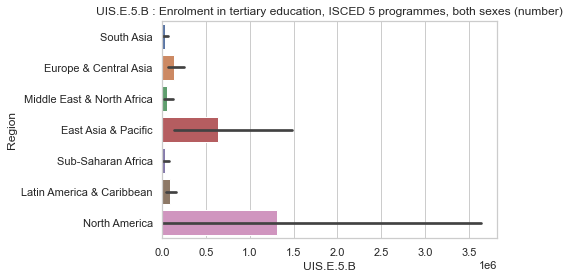

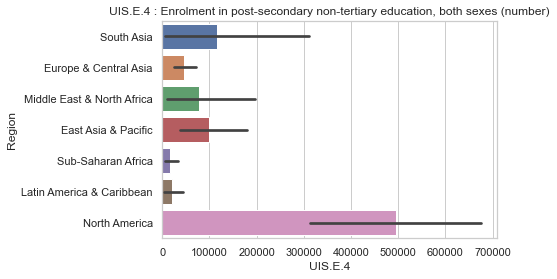

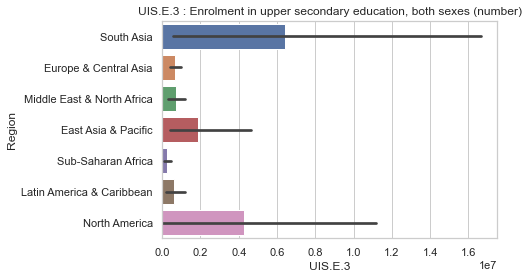

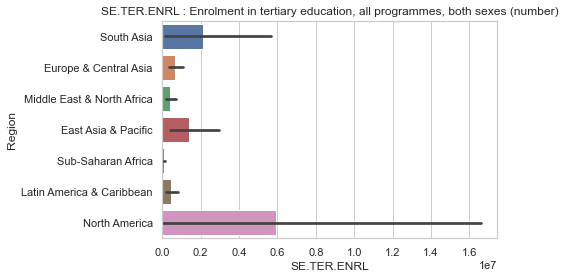

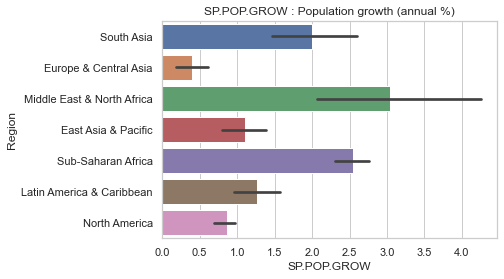

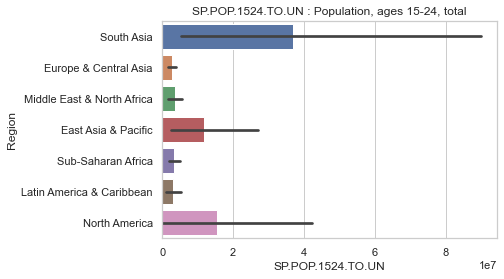

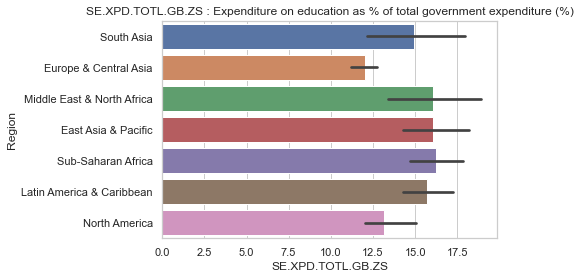

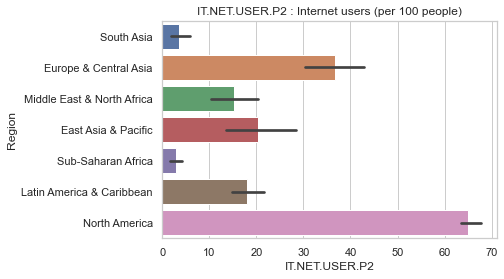

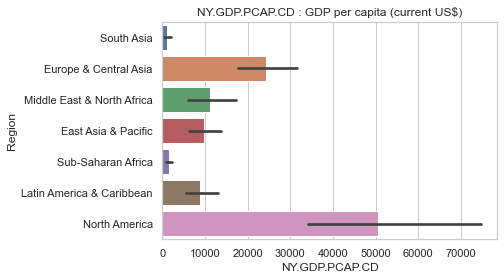

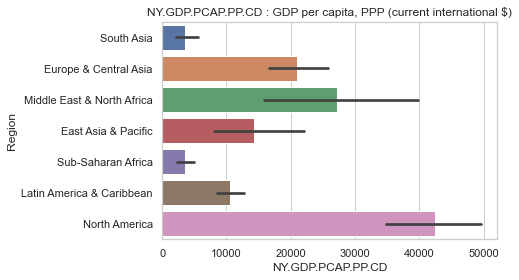

Indicateurs par Region pour les années 2000


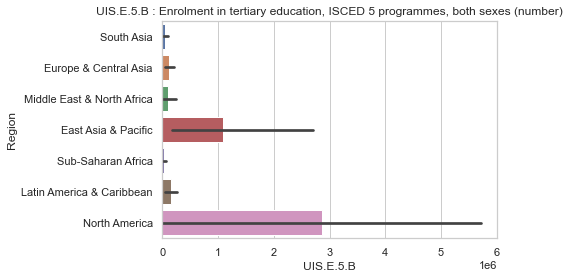

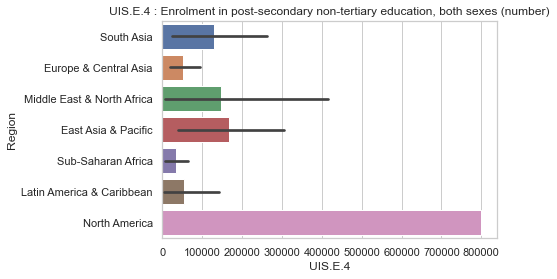

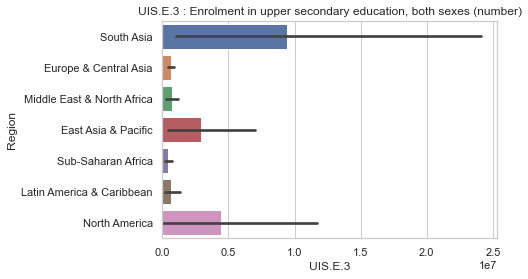

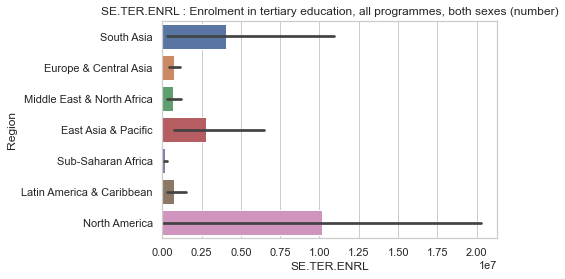

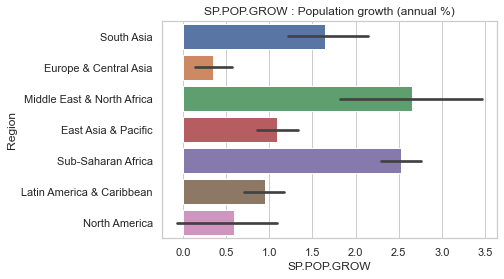

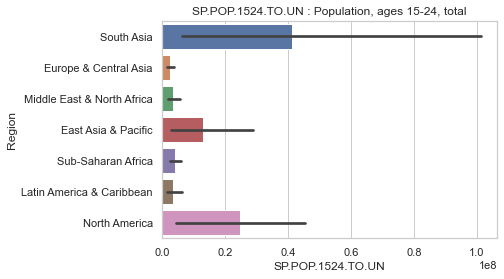

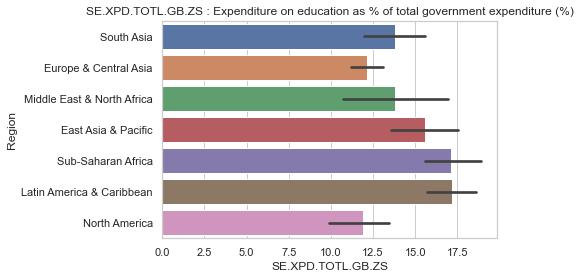

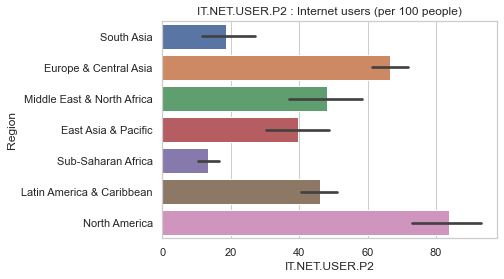

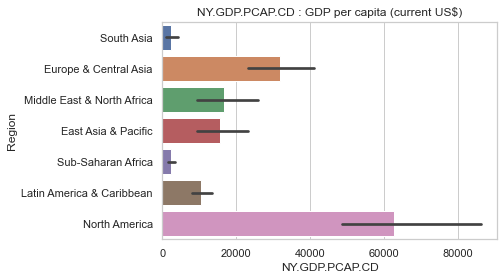

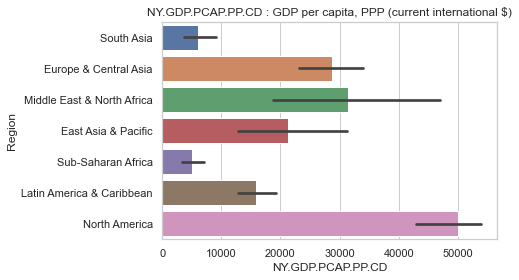

In [169]:
#2000s
print('Indicateurs par Region pour les années 2000')
for indicateur in indicateurs:
    if df_Reduced[df_Reduced['Indicator Code'].isin([indicateur])].count().sum()>0:
        title=indicateur + ' : ' + df_Reduced[df_Reduced['Indicator Code'] == indicateur]['Indicator Name'].unique()[0]
        plt.title(title)
        ax=plt.gca()
        plot=sns.barplot(x=df_Cdata2000s[indicateur],y=df_Cdata2000s['Region'])
        #show_values_on_bars(plot,'h',0.4)
        plt.show()
    else:
        print(indicateur, ' : rien à afficher')
#2010s
print('Indicateurs par Region pour les années 2000')
for indicateur in indicateurs:
    if df_Reduced[df_Reduced['Indicator Code'].isin([indicateur])].count().sum()>0:
        title=indicateur + ' : ' + df_Reduced[df_Reduced['Indicator Code'] == indicateur]['Indicator Name'].unique()[0]
        plt.title(title)
        ax=plt.gca()
        plot=sns.barplot(x=df_Cdata2010s[indicateur],y=df_Cdata2010s['Region'])
        #show_values_on_bars(plot,'h',0.4)
        plt.show()
    else:
        print(indicateur, ' : rien à afficher')

Médiane des indicateurs par Region pour les années 2000


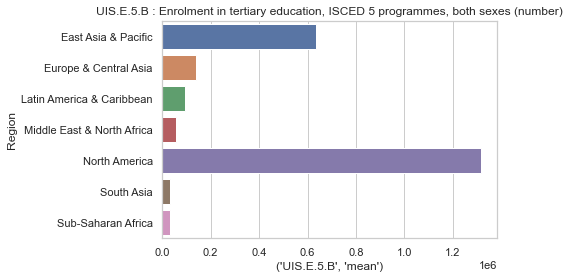

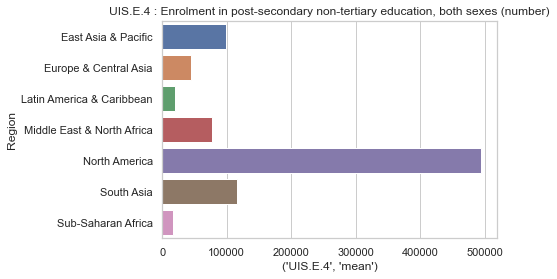

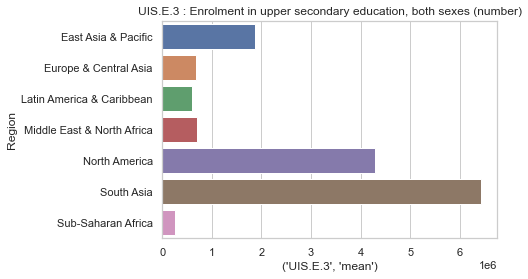

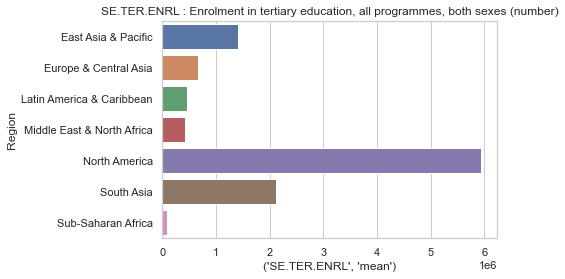

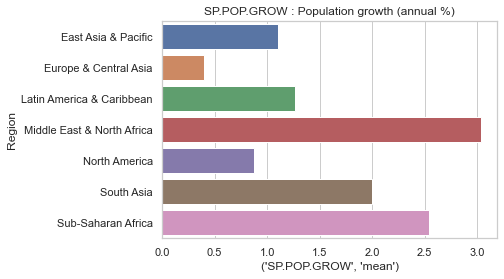

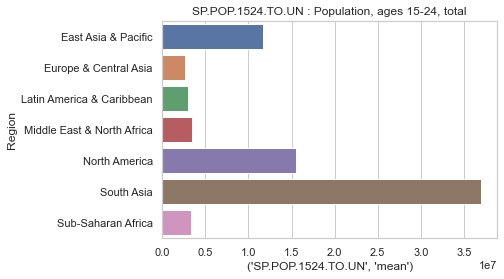

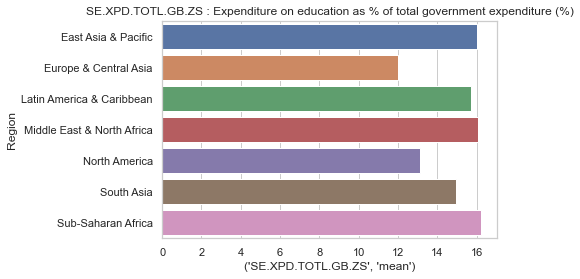

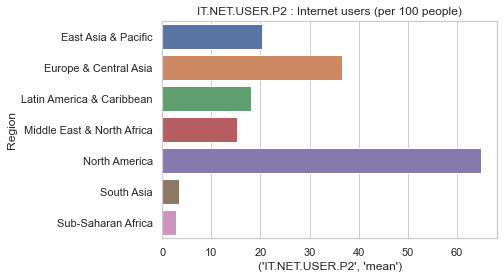

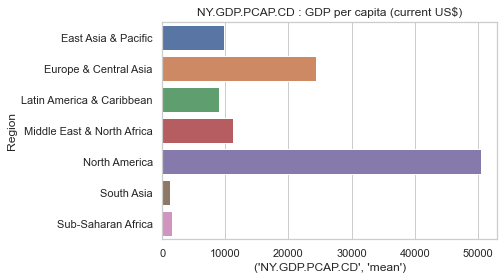

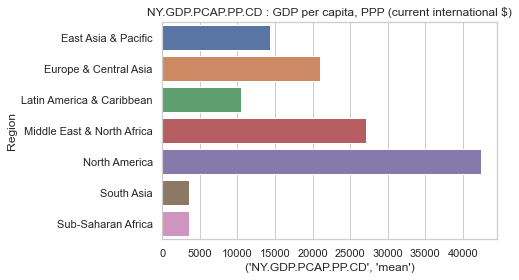

Médiane des indicateurs par Region pour les années 2000


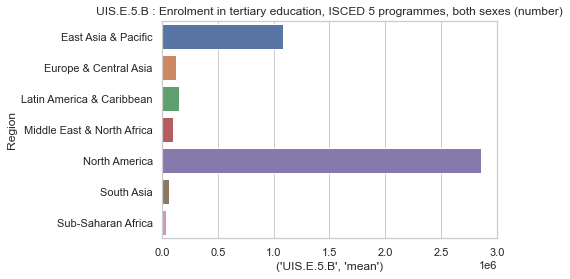

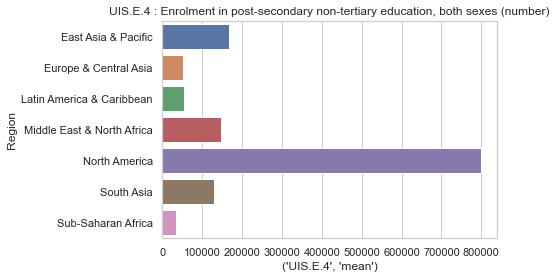

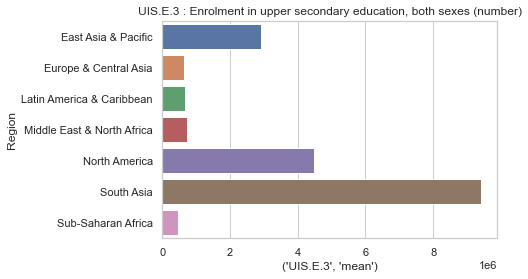

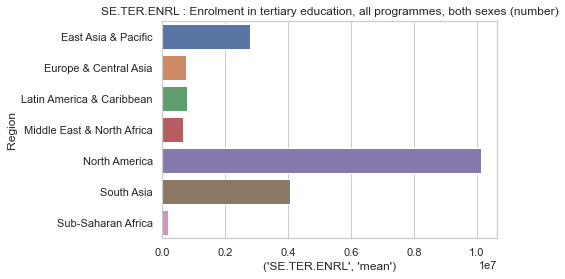

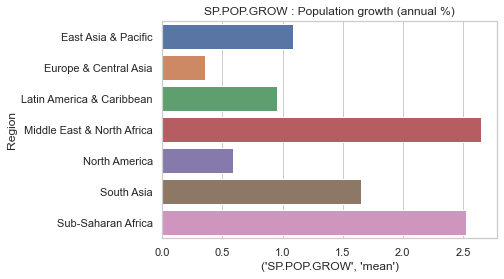

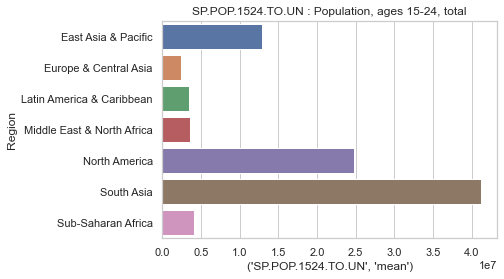

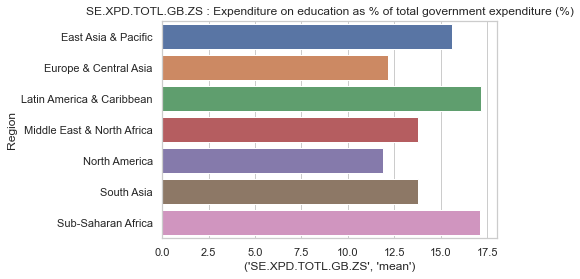

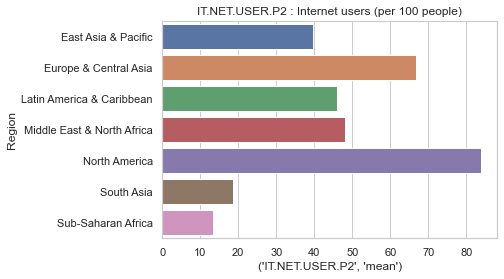

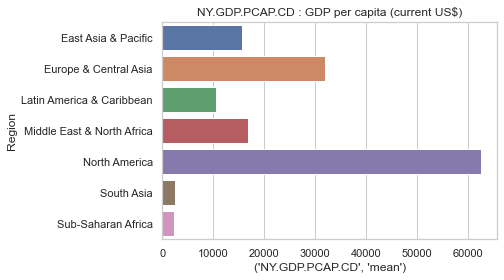

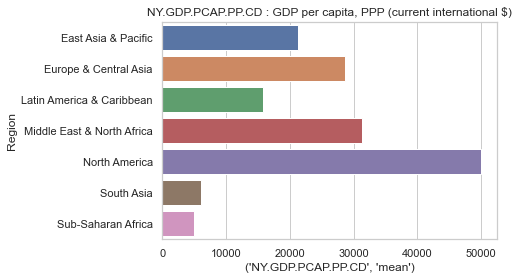

In [170]:
#2000s
print('Médiane des indicateurs par Region pour les années 2000')
for indicateur in indicateurs:
    if df_Reduced[df_Reduced['Indicator Code'].isin([indicateur])].count().sum()>0:
        title=indicateur + ' : ' + df_Reduced[df_Reduced['Indicator Code'] == indicateur]['Indicator Name'].unique()[0]
        plt.title(title)
        ax=plt.gca()
        plot=sns.barplot(x=calc_dfRdata2000s[(indicateur,'mean')],y=calc_dfRdata2000s['Region'])
        #show_values_on_bars(plot,'h',0.4)
        plt.show()
    else:
        print(indicateur, ' : rien à afficher')
#2010s
print('Médiane des indicateurs par Region pour les années 2000')
for indicateur in indicateurs:
    if df_Reduced[df_Reduced['Indicator Code'].isin([indicateur])].count().sum()>0:
        title=indicateur + ' : ' + df_Reduced[df_Reduced['Indicator Code'] == indicateur]['Indicator Name'].unique()[0]
        plt.title(title)
        ax=plt.gca()
        plot=sns.barplot(x=calc_dfRdata2010s[(indicateur,'mean')],y=calc_dfRdata2010s['Region'])
        #show_values_on_bars(plot,'h',0.4)
        plt.show()
    else:
        print(indicateur, ' : rien à afficher')

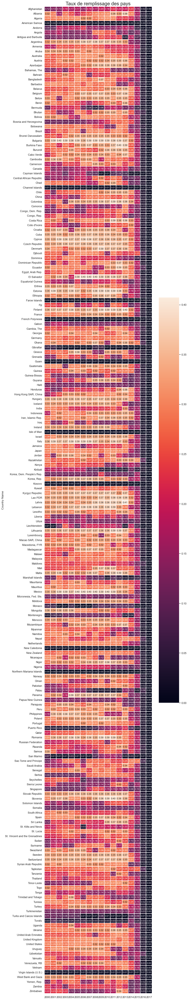

In [171]:
search=df_Reduced[~df_Reduced['Country Name'].isin(zones)][['Country Name','2000','2001','2002','2003','2004','2005','2006','2007','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017']].groupby(['Country Name']).count().div(len(df_Reduced[~df_Reduced['Indicator Name'].isin(zones)])).multiply(100)
plt.figure(figsize=(10,75))
plt.title("Taux de remplissage des pays",size=20)
sns.heatmap(search,annot=True,fmt='.2f',linewidths=.3,annot_kws={"size": 10})
plt.show()

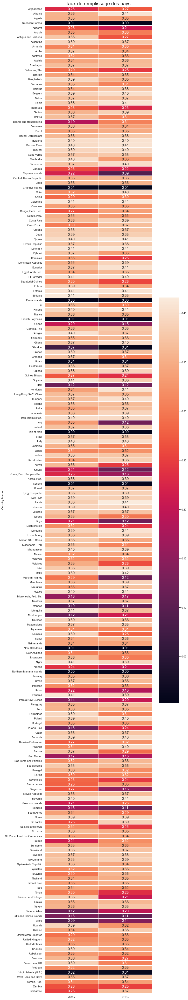

In [172]:
search=df_Reduced[~df_Reduced['Country Name'].isin(zones)][['Country Name','2000s','2010s']].groupby(['Country Name']).count().div(len(df_Reduced[~df_Reduced['Indicator Name'].isin(zones)])).multiply(100)
plt.figure(figsize=(10,75))
plt.title("Taux de remplissage des pays",size=20)
sns.heatmap(search,annot=True,fmt='.2f',linewidths=.3,annot_kws={"size": 15})
plt.show()

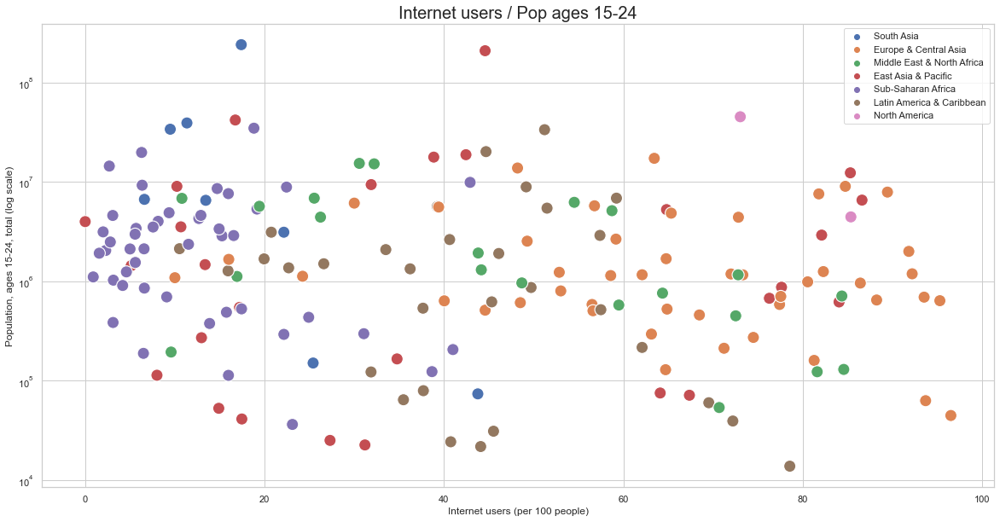

In [173]:
plt.figure(figsize=(20,10))
ax=plt.gca()
sns.scatterplot(df_Cdata2010s['IT.NET.USER.P2'],df_Cdata2010s['SP.POP.1524.TO.UN'],hue=df_Cdata2010s['Region'],s=200)
ax.set_yscale('log')
plt.legend(loc='upper right')
plt.xlabel('Internet users (per 100 people)')
plt.ylabel('Population, ages 15-24, total (log scale)')
plt.title('Internet users / Pop ages 15-24', size=20)
plt.show()

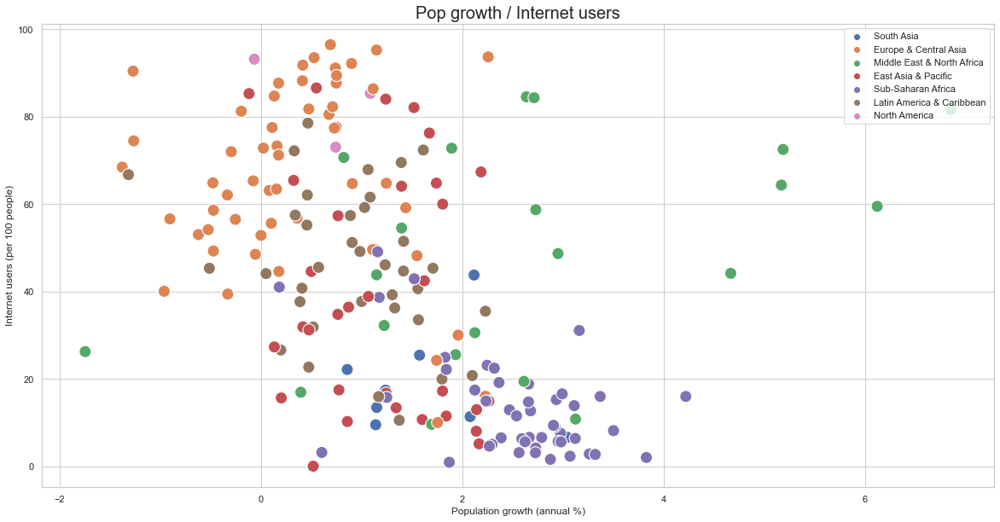

In [174]:
plt.figure(figsize=(20,10))
ax=plt.gca()
sns.scatterplot(df_Cdata2010s['SP.POP.GROW'],df_Cdata2010s['IT.NET.USER.P2'],hue=df_Cdata2010s['Region'],s=200)
#ax.set_xscale('log')
plt.legend(loc='upper right')
plt.ylabel('Internet users (per 100 people)')
plt.xlabel('Population growth (annual %)')
plt.title('Pop growth / Internet users', size=20)
plt.show()

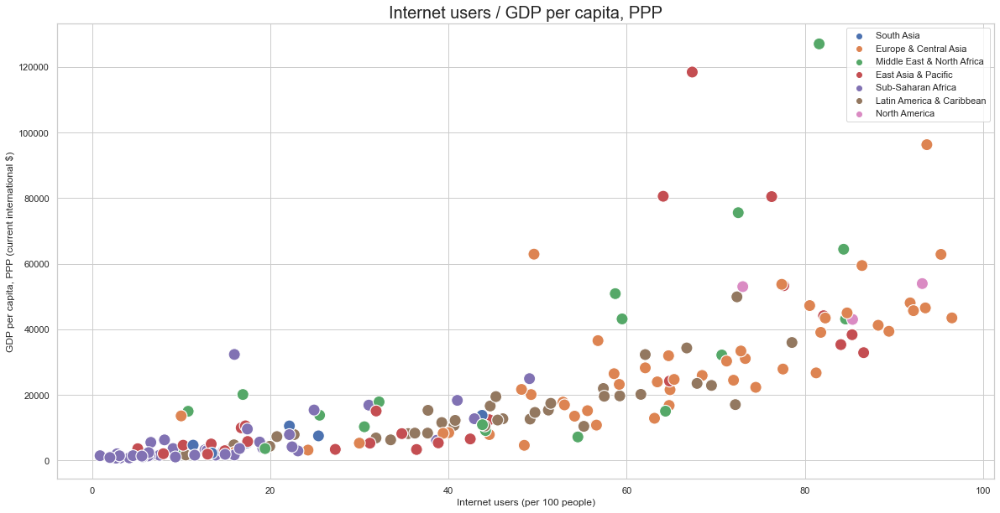

In [175]:
plt.figure(figsize=(20,10))
ax=plt.gca()
sns.scatterplot(df_Cdata2010s['IT.NET.USER.P2'],df_Cdata2010s['NY.GDP.PCAP.PP.CD'],hue=df_Cdata2010s['Region'],s=200)
#ax.set_xscale('log')
plt.legend(loc='upper right')
plt.ylabel('GDP per capita, PPP (current international $)')
plt.xlabel('Internet users (per 100 people)')
plt.title('Internet users / GDP per capita, PPP', size=20)
plt.show()

In [176]:
df_dataFiltered = data[data['Indicator Code'].isin(indicateurs)]
df_dataFiltered.drop('Unnamed: 69',inplace=True,axis=1)

In [177]:
df_dataFiltered_melt = df_dataFiltered.melt(id_vars=['Country Name','Country Code','Indicator Name',
                                                     'Indicator Code'],value_vars = ['1970', '1971', '1972', '1973', 
                                                                                     '1974', '1975', '1976', '1977', 
                                                                                     '1978', '1979', '1980', '1981', 
                                                                                     '1982', '1983', '1984', '1985', 
                                                                                     '1986', '1987', '1988', '1989', 
                                                                                     '1990', '1991', '1992', '1993', 
                                                                                     '1994', '1995', '1996', '1997', 
                                                                                     '1998', '1999', '2000', '2001', 
                                                                                     '2002', '2003', '2004', '2005', 
                                                                                     '2006', '2007', '2008', '2009', 
                                                                                     '2010', '2011', '2012', '2013', 
                                                                                     '2014', '2015', '2016', '2017', 
                                                                                     '2020', '2025', '2030', '2035', 
                                                                                     '2040', '2045', '2050', '2055', 
                                                                                     '2060', '2065', '2070', '2075', 
                                                                                     '2080', '2085', '2090', '2095', 
                                                                                     '2100'],
                                            var_name = 'Year', value_name = 'Value')

In [178]:
df_Cdata2010s[(df_Cdata2010s['IT.NET.USER.P2']>=df_Cdata2010s['IT.NET.USER.P2'].median())
              &(df_Cdata2010s['SP.POP.GROW']>=0.1)
              &(df_Cdata2010s['SP.POP.1524.TO.UN']>=df_Cdata2010s['SP.POP.1524.TO.UN'].mean())
             ].sort_values(by='NY.GDP.PCAP.PP.CD',ascending=False).reset_index()[['Country Name','NY.GDP.PCAP.PP.CD']]

,Country Name,NY.GDP.PCAP.PP.CD
0,United States,53015.345
1,Germany,45000.383
2,United Kingdom,39396.005
3,France,39069.030
4,Russian Federation,23958.898
5,Turkey,21665.777
6,Argentina,19694.726
7,Mexico,16618.882
8,Brazil,15367.941
9,South Africa,12728.272


In [179]:
df_Cdata2010s['NY.GDP.PCAP.PP.CD'].median()

12228.69595192783

Tous les pays choisis ont un PIB per capita à PPA supérieure à la médiane mondiale. Cela garantit que les clients potentiels auront les ressources nécessaires pour financer certains des services proposés.

In [180]:
paysInteresantes=['United States','Germany','United Kingdom','France',
                  'Russian Federation','Turkey','Argentina','Mexico',
                 'Brazil','South Africa','Colombia','China']

In [181]:
df_dataFiltered_melt['Year'] = df_dataFiltered_melt['Year'].astype('int32')
df_dataFiltered_melt = df_dataFiltered_melt[df_dataFiltered_melt['Year']>1999]
df_dataFiltered_melt = df_dataFiltered_melt[df_dataFiltered_melt['Country Name'].isin(paysInteresantes)].reset_index()

In [182]:
df_dataFiltered_melt.sample(10)

,index,Country Name,Country Code,Indicator Name,Indicator Code,Year,Value
4001,153381,France,FRA,"Enrolment in tertiary education, all programmes, both sexes (number)",SE.TER.ENRL,2095,NaN
2300,119240,China,CHN,"Enrolment in post-secondary non-tertiary education, both sexes (number)",UIS.E.4,2025,NaN
124,75344,Argentina,ARG,Expenditure on education as % of total government expenditure (%),SE.XPD.TOTL.GB.ZS,2001,16.358
2537,123937,Brazil,BRA,Internet users (per 100 people),IT.NET.USER.P2,2035,NaN
2931,131651,Germany,DEU,"Enrolment in tertiary education, all programmes, both sexes (number)",SE.TER.ENRL,2050,NaN
285,78365,France,FRA,GDP per capita (current US$),NY.GDP.PCAP.CD,2002,24275.243
3768,148548,France,FRA,Population growth (annual %),SP.POP.GROW,2085,NaN
3393,141033,Colombia,COL,"Enrolment in upper secondary education, both sexes (number)",UIS.E.3,2070,NaN
1757,108337,Russian Federation,RUS,Internet users (per 100 people),IT.NET.USER.P2,2014,70.520
3637,145877,Colombia,COL,Internet users (per 100 people),IT.NET.USER.P2,2080,NaN


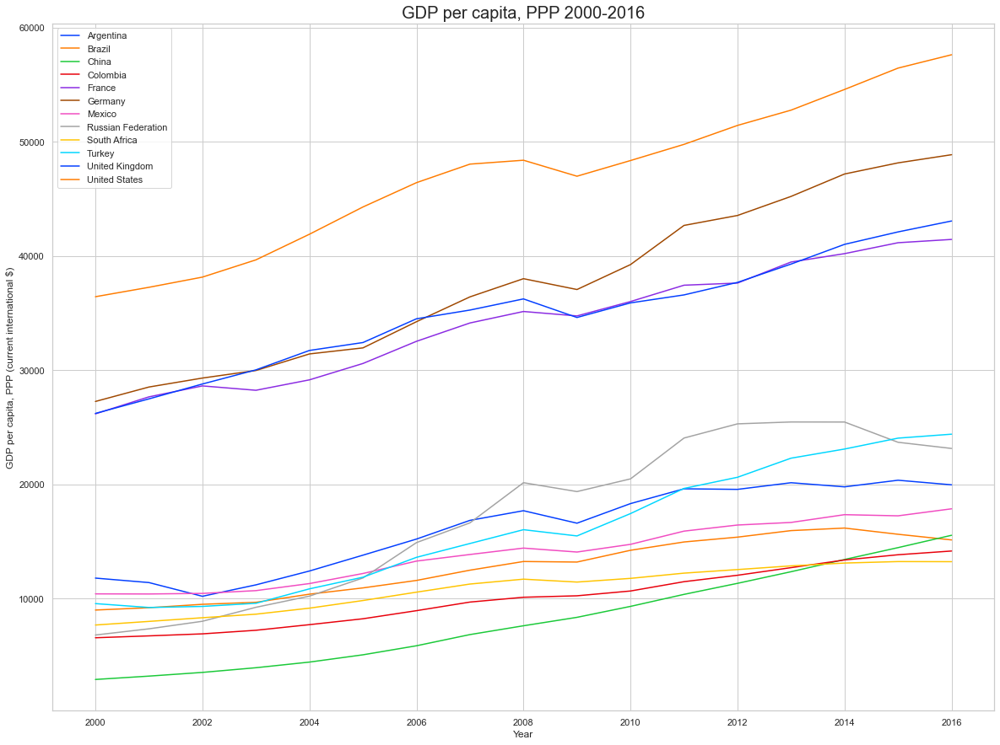

In [183]:
df_forgraphs = df_dataFiltered_melt[df_dataFiltered_melt['Year']<=2016]
plt.figure(figsize=(20,15))
sns.lineplot(x=df_forgraphs[df_forgraphs['Indicator Code']=='NY.GDP.PCAP.PP.CD']['Year'],
            y=df_forgraphs[df_forgraphs['Indicator Code']=='NY.GDP.PCAP.PP.CD']['Value'],
            hue=df_forgraphs['Country Name'],palette='bright')
plt.ylabel('GDP per capita, PPP (current international $)')
plt.xlabel('Year')
plt.title('GDP per capita, PPP 2000-2016', size=20)
plt.legend(loc='upper left')
plt.show()

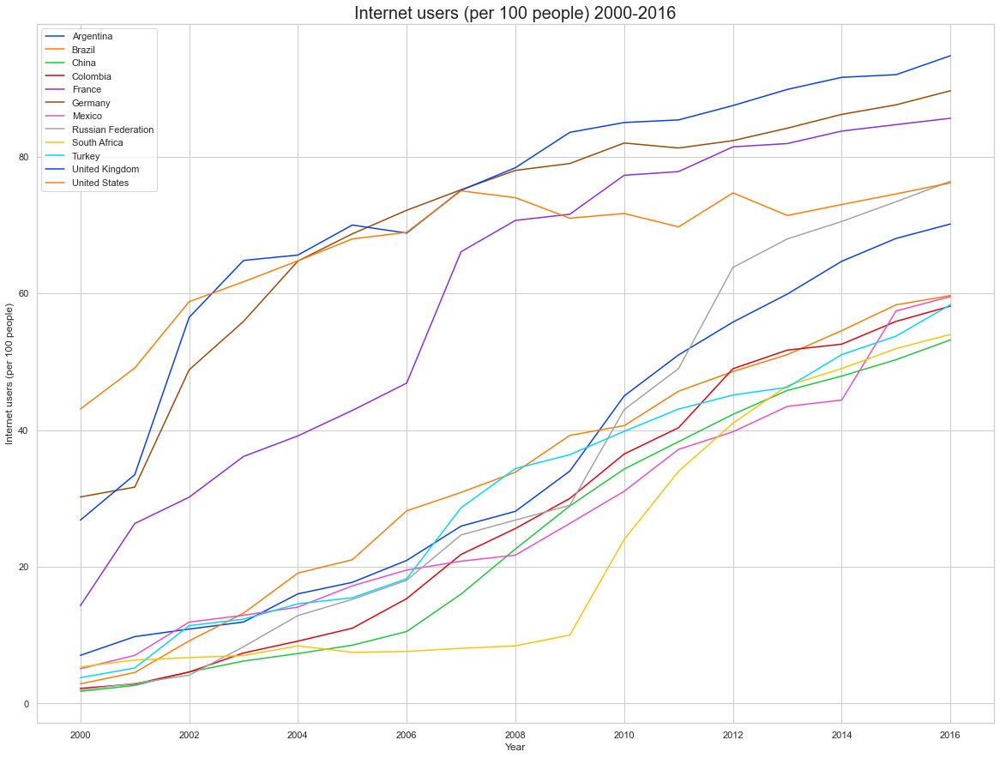

In [184]:
plt.figure(figsize=(20,15))
sns.lineplot(x=df_forgraphs[df_forgraphs['Indicator Code']=='IT.NET.USER.P2']['Year'],
            y=df_forgraphs[df_forgraphs['Indicator Code']=='IT.NET.USER.P2']['Value'],
            hue=df_forgraphs['Country Name'],palette='bright')
plt.ylabel('Internet users (per 100 people)')
plt.xlabel('Year')
plt.title('Internet users (per 100 people) 2000-2016', size=20)
plt.legend(loc='upper left')
plt.show()

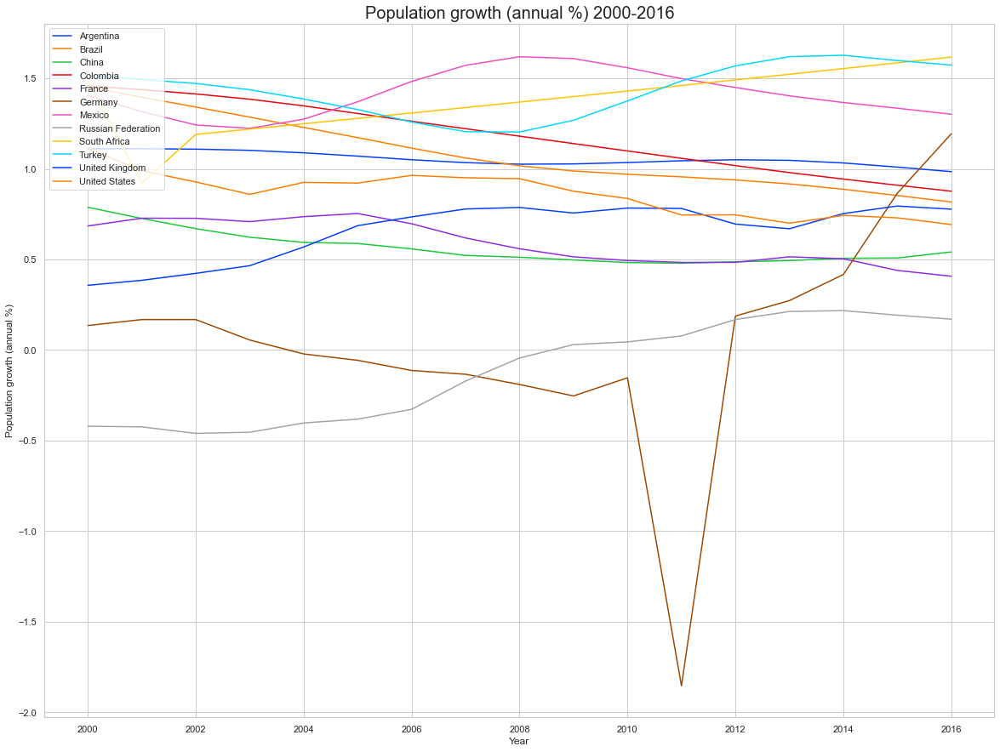

In [185]:
plt.figure(figsize=(20,15))
sns.lineplot(x=df_forgraphs[df_forgraphs['Indicator Code']=='SP.POP.GROW']['Year'],
            y=df_forgraphs[df_forgraphs['Indicator Code']=='SP.POP.GROW']['Value'],
            hue=df_forgraphs['Country Name'],palette='bright')
plt.ylabel('Population growth (annual %)')
plt.xlabel('Year')
plt.title('Population growth (annual %) 2000-2016', size=20)
plt.legend(loc='upper left')
plt.show()

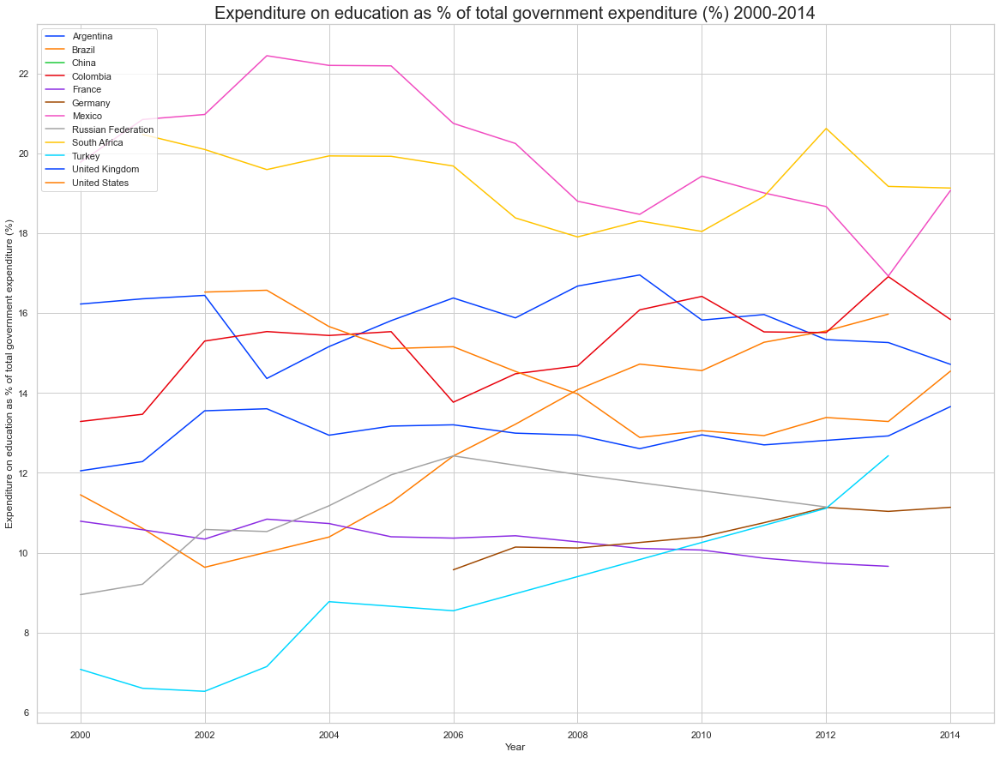

In [186]:
df_graph = df_dataFiltered_melt[df_dataFiltered_melt['Year']<=2014]
plt.figure(figsize=(20,15))
sns.lineplot(x=df_graph[df_graph['Indicator Code']=='SE.XPD.TOTL.GB.ZS']['Year'],
            y=df_graph[df_graph['Indicator Code']=='SE.XPD.TOTL.GB.ZS']['Value'],
            hue=df_graph['Country Name'],palette='bright')
plt.ylabel('Expenditure on education as % of total government expenditure (%)')
plt.xlabel('Year')
plt.title('Expenditure on education as % of total government expenditure (%) 2000-2014', size=20)
plt.legend(loc='upper left')
plt.show()

In [187]:
df_temp = df_dataFiltered_melt.copy()
df_temp['Value']=df_temp['Value'].fillna(0)
for country in paysInteresantes:
    for year in df_temp['Year'].unique().tolist():
        df_temp = df_temp.append({'Country Name' : country,'Country Code' : '','Indicator Name' : '','Indicator Code' : 'ENROL','Year' : int(year),
                                  'Value' :  df_temp[df_temp['Indicator Code']=='UIS.E.3'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]+df_temp[df_temp['Indicator Code']=='UIS.E.4'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]+df_temp[df_temp['Indicator Code']=='UIS.E.5.B'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]+df_temp[df_temp['Indicator Code']=='SE.TER.ENRL'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]},ignore_index=True)

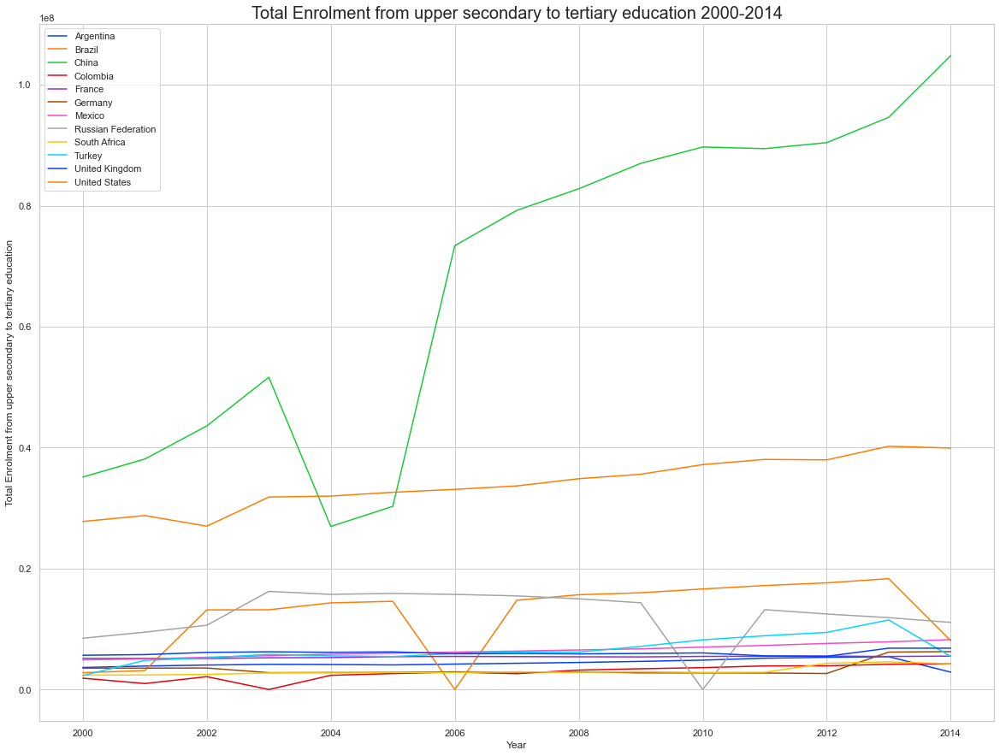

In [188]:
df_graph = df_temp[df_temp['Year']<=2014]
plt.figure(figsize=(20,15))
sns.lineplot(x=df_graph[df_graph['Indicator Code']=='ENROL']['Year'],
            y=df_graph[df_graph['Indicator Code']=='ENROL']['Value'],
            hue=df_graph['Country Name'],palette='bright')
plt.ylabel('Total Enrolment from upper secondary to tertiary education')
plt.xlabel('Year')
plt.title('Total Enrolment from upper secondary to tertiary education 2000-2014', size=20)
plt.legend(loc='upper left')
plt.show()

Nous complétons le NAN avec la moyenne de chaque indicateur par pays.

In [189]:
df_dataFiltered_melt['Value']=df_dataFiltered_melt['Value'].fillna(df_dataFiltered_melt.groupby(['Country Name','Indicator Code'])['Value'].transform('mean'))

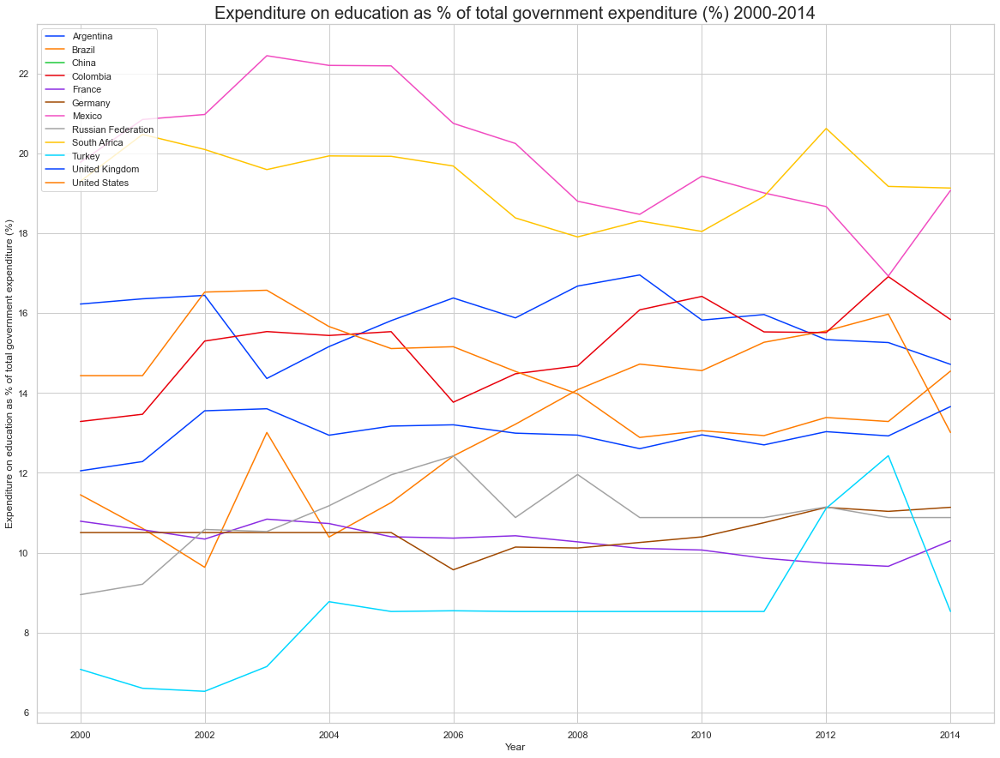

In [190]:
df_f_graph = df_dataFiltered_melt[df_dataFiltered_melt['Year']<=2014]
plt.figure(figsize=(20,15))
sns.lineplot(x=df_f_graph[df_f_graph['Indicator Code']=='SE.XPD.TOTL.GB.ZS']['Year'],
            y=df_f_graph[df_f_graph['Indicator Code']=='SE.XPD.TOTL.GB.ZS']['Value'],
            hue=df_f_graph['Country Name'],palette='bright')
plt.ylabel('Expenditure on education as % of total government expenditure (%)')
plt.xlabel('Year')
plt.title('Expenditure on education as % of total government expenditure (%) 2000-2014', size=20)
plt.legend(loc='upper left')
plt.show()

In [191]:
df_temp = df_dataFiltered_melt.copy()
df_temp['Value']=df_temp['Value'].fillna(0)
for country in paysInteresantes:
    for year in df_temp['Year'].unique().tolist():
        df_temp = df_temp.append({'Country Name' : country,'Country Code' : '','Indicator Name' : '','Indicator Code' : 'ENROL','Year' : int(year),
                                  'Value' :  df_temp[df_temp['Indicator Code']=='UIS.E.3'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]+df_temp[df_temp['Indicator Code']=='UIS.E.4'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]+df_temp[df_temp['Indicator Code']=='UIS.E.5.B'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]+df_temp[df_temp['Indicator Code']=='SE.TER.ENRL'][df_temp['Country Name']==country][df_temp['Year']==int(year)]['Value'].iloc[0]},ignore_index=True)

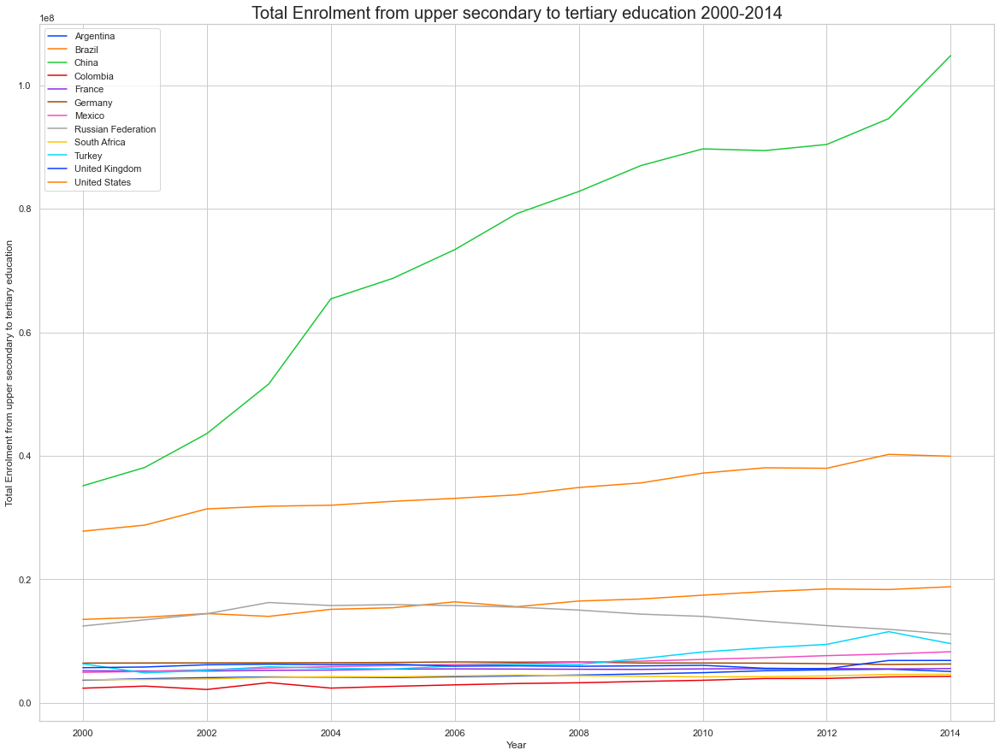

In [192]:
df_graph = df_temp[df_temp['Year']<=2014]
plt.figure(figsize=(20,15))
sns.lineplot(x=df_graph[df_graph['Indicator Code']=='ENROL']['Year'],
            y=df_graph[df_graph['Indicator Code']=='ENROL']['Value'],
            hue=df_graph['Country Name'],palette='bright')
plt.ylabel('Total Enrolment from upper secondary to tertiary education')
plt.xlabel('Year')
plt.title('Total Enrolment from upper secondary to tertiary education 2000-2014', size=20)
plt.legend(loc='upper left')
plt.show()

In [193]:
indicateurs.append('ENROL')

In [194]:
x1=df_temp[(df_temp['Year']>2018) & (df_temp['Indicator Code']=='ENROL')]['Year']
df_fitted = pd.DataFrame(columns=['Country Name','Indicator Code','Year','slope','intercept'])
for indicateur in indicateurs :
    for country in paysInteresantes :
        for year in df_temp['Year'].unique().tolist():
            x=df_temp[(df_temp['Year']<2018) & (df_temp['Indicator Code']==indicateur) & (df_temp['Country Name']==country)]['Year']
            y=df_temp[(df_temp['Year']<2018) & (df_temp['Indicator Code']==indicateur) & (df_temp['Country Name']==country)]['Value']
            slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
            df_fitted=df_fitted.append({'Country Name' : country,'Indicator Code' : indicateur,'Year' : int(year),'slope' : slope,'intercept' : intercept},ignore_index=True)
df_fitted['y']=df_fitted['intercept']+df_fitted['slope']*df_fitted['Year']
df_fitted['y']=df_fitted['y'].astype('float')

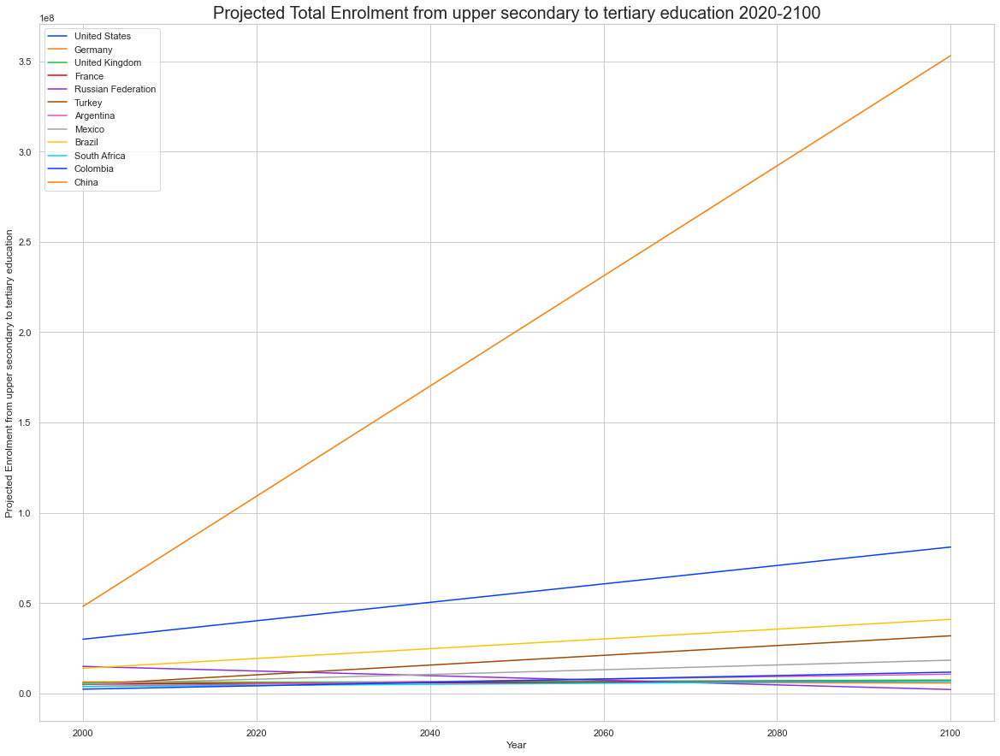

In [195]:
plt.figure(figsize=(20,15))
sns.lineplot(x=df_fitted[df_fitted['Indicator Code']=='ENROL']['Year'],
            y=df_fitted[df_fitted['Indicator Code']=='ENROL']['y'],
            hue=df_fitted['Country Name'],palette='bright')
plt.ylabel('Projected Enrolment from upper secondary to tertiary education')
plt.xlabel('Year')
plt.title('Projected Total Enrolment from upper secondary to tertiary education 2020-2100', size=20)
plt.legend(loc='upper left')
plt.show()

Les pays **'United States','Germany','United Kingdom','France','Russian Federation','Turkey','Argentina','Mexico','Brazil','South Africa','Colombia','China'** ont été choisis selon les paramètres suivants:
- Internautes (pour 100 personnes) : Supérieurs à la médiane mondiale
- Croissance démographique (% annuel) : Positive (supérieure à 0.1%)
- Population âgée de 15 à 24 ans : Supérieure à la moyenne mondiale
- PIB per capita à PPA : Supérieur à la médiane mondiale de 12229 USD

On peut supposer que :

- les pays à croissance démographique annuelle positive maintiendront une tendance à la hausse en ce qui concerne le nombre de clients potentiels
- tous les pays vont continuer à augmenter les internautes et par conséquent le nombre de clients potentiels
- l'augmentation du PIB per capita à PPA (parité du pouvoir d'achat) implique une augmentation des ressources disponibles pour la population qui peut potentiellement être investie dans l'éducation
- la plupart des pays réduisent leurs investissements dans l'éducation. Les ménages augmenteront leurs dépenses d'éducation, ce qui peut être bénéfique pour les entités privées qui ne dépendent pas des investissements publics

L'entreprise est française, nous supprimons donc la **France** de la liste.

Concernant la présente situation géopolitique, les éléments suivants doivent être pris en compte :

- L'**Argentine** a actuellement d'importantes limitations sur le marché des changes, ce qui rend presque impossible de souscrire des services étrangers
- La **Turquie** est dans une période de haute tension militaire avec la France et d'autres pays membres de l'UE
- En raison de la guerre commerciale entre les **États-Unis** et la **Chine**, les entreprises doivent choisir avec qui faire des affaires
- Le **Royaume-Uni**, on doit attendre la fin du Brexit pour analyser les nouvelles réglementations commerciales
- La **Russie** fait actuellement face à plusieurs sanctions internationales, c'est pourquoi les russes ont le désir de ne payer qu'en roubles, ce qui rend difficile le commerce avec eux dans une autre devise

Sur la base des détails présentés, nous avons décidé de retirer l'**Argentine** de la liste.
En ce qui concerne la **Turquie**, la **Russie**, la **Chine**, les **États-Unis** et le **Royaume-Uni**, nous conseillons une analyse approfondie des coûts et des avantages de l'expansion dans chacun de ces pays.

## **Choix final**

| Country |
| --- | 
| United States |
| Germany |
| United Kingdom |
| Russian Federation |
| Turkey |
| Brazil |
| South Africa |
| Colombia |
| China |

Cependant, les pays à prioriser sont :
- les trois principaux PIB per capita à PPA
- le pays avec la plus grande population potentielle de clients et avec la plus grande projection de clients potentiels

| Country |
| --- | 
| United States |
| Germany |
| United Kingdom |
| China |

## **Conclusions**

Les fichiers csv sources contiennent tous les pays du monde et tous les indicateurs y sont détaillés. La source EdStatsData.csv contient principalement des indicateurs liés à l'éducation (investissement, inscriptions, etc) même si elle dispose de données, telles que la mortalité et l'emploi.

La source possède des données suffisamment variées et détaillées pour comparer les pays et répondre à la problématique mais avec certaines limitations que nous détaillerons ci-dessous.

La distribution des données manquantes n'est pas homogène ce qui ajoute un certain degré de complexité lors de la construction d'indicateurs. Un autre problème à prendre en compte est qu'il existe seulement deux indicateurs relatifs à Internet et que les indicateurs relatifs à l'éducation ne contiennent pas d'informations sur l'éducation en ligne.

Comme détaillé ci-dessus, la réalité géopolitique nécessite une analyse plus approfondie pour donner une vraie réponse à la problématique. De plus, il faut garder à l'esprit que même s'il est intéressant de s'installer dans des pays comme la Chine ou la Turquie, il faut considérer le contenu déjà existant sur la plateforme. Le plus cohérent serait de s'étendre, dans un premier temps, aux pays francophones et ensuite de continuer avec l'anglais car c'est la langue la plus parlée dans le monde.